In [1]:
import os
import glob
import pickle
import pandas as pd
import numpy as np
import scipy.stats as stats
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
from sklearn import linear_model
from IPython.display import Image
from sklearn.neighbors import KernelDensity

In [2]:
def load_average_scores():
    rsivl = "/ptmp/tshen/shared/RSIVL/labels.xls"
    visc = "/ptmp/tshen/shared/VISC/VISC-C/labels.csv"

    labels = {}
    labels['rsivl'] = pd.read_excel(rsivl)
    labels['rsivl'].rename(columns={'subjective scores': 'complexity', 'Unnamed: 0': 'filename'}, inplace=True)
    labels['rsivl']['filename'] = labels['rsivl']['filename'] + ".bmp"
    labels['visc'] = pd.read_csv(visc)
    labels['visc'].rename(columns={'score': 'complexity', 'image': 'filename'}, inplace=True)

    for k in labels.keys():
        assert labels[k][['filename', 'complexity']].isnull().values.any() == False

    return labels

In [3]:
def load_predictions(folder="../out/2023July20", filenames=['4points', '8points', '16points', '32points', '64points']):
    rsivl = "{}/RSIVL".format(folder)
    visc = "{}/VISC".format(folder)

    preds = {}
    
    for v, n in zip([rsivl, visc], ["rsivl", "visc"]):
        preds_dataset = []
        single_file_len = 0

        for f in filenames:
            df = pd.read_csv("{}/{}.csv".format(v, f), names=["filename", f], header=None)
            preds_dataset.append(df)
            single_file_len = len(df)

        combined_df = pd.concat([df.set_index("filename") for df in preds_dataset], axis=1, join='inner').reset_index()  # join on filename
        assert len(combined_df) == single_file_len
        assert combined_df.isnull().values.any() == False

        preds[n] = combined_df

    preds['rsivl']['filename'] = preds['rsivl']['filename'].str.replace('.json', '.bmp', regex=False)
    for k in ["visc"]:
        preds[k]['filename'] = preds[k]['filename'].str.replace('.json', '.jpg', regex=False)

    return preds

In [4]:
def load_subject_scores():
    rsivl = "/ptmp/tshen/shared/subject_level_data/rsivl_labels.csv"
    visc = "/ptmp/tshen/shared/subject_level_data/visc_labels.csv"
    visc_participant_ratings = "/ptmp/tshen/shared/subject_level_data/visc_participant_files/"

    labels = {}
    labels['rsivl'] = pd.read_csv(rsivl)
    labels['visc'] = pd.read_csv(visc)

    files = glob.glob(visc_participant_ratings + "*.csv")

    participant_ratings_list = []
    for f in files:
        df = pd.read_csv(f)
        base = os.path.basename(f)
        df = df.rename(columns={"image":"filename", "score": "participant{}".format(os.path.splitext(base)[0])})        
        participant_ratings_list.append(df)

    participant_df = pd.concat([df.set_index('filename') for df in participant_ratings_list], axis=1, join='outer')
    labels['visc'] = pd.concat([labels['visc'].set_index('filename'), participant_df], axis=1, join='outer')
    labels['visc']['filename'] = labels['visc'].index

    return labels

In [5]:
def join_preds_labels(preds, avg_labels, subject_labels, num_class):
    data = {}
    
    for k in ["rsivl", "visc"]:
        data[k] = pd.concat(
            [df.set_index("filename") for df in [preds[k], avg_labels[k][['filename', 'complexity']], num_class[k], subject_labels[k]]], 
            axis=1, join='inner').reset_index()

        if k == 'rsivl':
            data[k]['computed_average'] = data[k][['participant{}'.format(i) for i in range(1, 27)]].mean(axis=1)

        elif k == 'visc':
            data[k]['computed_average'] = data[k][['rating{}'.format(i) for i in range(1, 11)]].mean(axis=1)

        if k != 'ic9600':
            assert len(data[k]) == len(preds[k]) == len(avg_labels[k]) == len(subject_labels[k])
        else:
            pass

    assert data['rsivl'].isnull().values.any() == False
    for i in range(1, 41):
        assert data['visc']['participant{}'.format(i)].isna().sum() == (800-200)

    return data

In [6]:
def load_num_class():
     data = pickle.load(open("./fcclip_labels.p", "rb"))
     data['sav_int'] = data['int']
     data['sav_obj'] = data['objects']
     data['sav_sce'] = data['scenes']
     data['sav_art'] = data['art']
     data['sav_sup'] = data['sup']
     del data['int']
     del data['objects']
     del data['scenes']
     del data['art']
     del data['sup']

     return data

In [7]:
levels = ['4points', '8points', '16points', '32points', '64points']

In [8]:
preds = load_predictions(folder="../out/2023July20", filenames=levels)
avg_labels = load_average_scores()
subject_labels = load_subject_scores()
num_class = load_num_class()
data = join_preds_labels(preds, avg_labels, subject_labels, num_class)

# Remove invalid rows

In [9]:
data['rsivl'] = data['rsivl'][data['rsivl'].participant1 != -9999]

In [10]:
assert len(data['rsivl']) == 48
assert (data['rsivl'] == -9999).sum(axis=0).sum() == 0

# Failure Modes

In [12]:
def rank_transform(s):
    return s.rank(axis=0, method="average")

In [13]:
def sqrt_xform(c):
    return np.sqrt(c)

In [14]:
def get_correlations(x, y):
    model = np.poly1d(np.polyfit(x, y, 1))                
    p, s, r = stats.pearsonr(x, y), stats.spearmanr(x, y), r2_score(y, model(x))
    print("{:.2f} {:.2f} {:.2f}".format(p.statistic, s.statistic, r))
    return p, s, r

In [15]:
participants = list(range(1, 41))
participants = [x for x in participants if x not in [7, 14, 28]]

In [16]:
## VISC by Category
import json
with open('/ptmp/tshen/shared/VISCHEMA_SUN/file_categories.json', 'r') as f:
    file_to_cats = json.load(f)
    
data['visc']['category'] = data['visc']['filename'].map(file_to_cats)

In [17]:
data['visc']['category'].unique()

array(['airport_terminal', 'living_room', 'playground', 'kitchen',
       'house', 'pasture', 'conference_room', 'amusement_park',
       'skyscraper', 'mountain', 'badlands', 'golf_course'], dtype=object)

In [18]:
def cat2(x):
    if x in ["airport_terminal"]:
        return "big"
    elif x in ["conference_room"]:
        return "small"
    elif x in ["amusement_park", "playground"]:
        return "public_ent"
    elif x in ["house", "skyscraper"]:
        return "work_home"
    elif x in ["golf_course", "pasture"]:
        return "populated"
    elif x in ["badlands", "mountain"]:
        return "isolated"
    else:
        return x
    
data['visc']['category2'] = data['visc']['category'].map(cat2)

In [19]:
def cat3(x):
    if x in ["kitchen", "living_room"]:
        return "private"
    elif x in ["big", "small"]:
        return "public"
    elif x in ["public_ent", "work_home"]:
        return "man_made"
    elif x in ["populated", "isolated"]:
        return "natural"
    else:
        return None
    
data['visc']['category3'] = data['visc']['category2'].map(cat3)

In [20]:
def cat4(x):
    if x in ["private", "public"]:
        return "indoor"
    elif x in ["man_made", "natural"]:
        return "outdoor"
    else:
        return None
    
data['visc']['category4'] = data['visc']['category3'].map(cat4)

In [21]:
color_map = {1: "brown", 2: "tomato", 3: "red", 4: "tan", 5: "orange", 6: "yellow", 7: "olivedrab", 8:"green", 9: "cyan", 10: "teal", 11: "blue", 12: "purple", 13: "gray"}

In [22]:
colors = [x[1] for x in sorted(color_map.items(), key=lambda x: x[0])]

In [23]:
x = sqrt_xform(data['visc']["64points"])
data['visc']['complexity_clean'] = data['visc'][["participant{}".format(i) for i in participants]].mean(axis=1)
y = data['visc']['complexity_clean']
result = get_correlations(x, y)

0.57 0.58 0.32


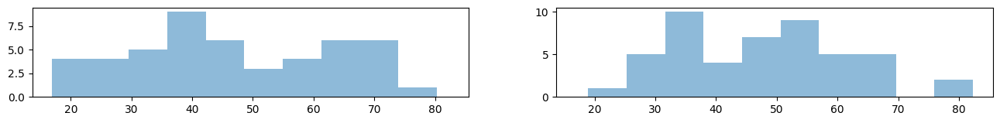

In [36]:
fig, axes = plt.subplots(1, 2, figsize=(16, 1.5), sharex=True)

model = linear_model.LinearRegression()
model.fit(sqrt_xform(data['rsivl']["64points"]).to_numpy().reshape(-1, 1), data["rsivl"]['computed_average'])
data['rsivl']['preds'] = model.predict(sqrt_xform(data['rsivl']["64points"]).to_numpy().reshape(-1, 1))

axes[0].hist(data["rsivl"]['computed_average'], bins=10, alpha=0.5)
axes[1].hist(data["rsivl"]['preds'], bins=10, alpha=0.5);

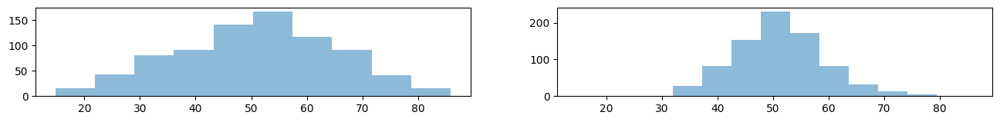

In [37]:
fig, axes = plt.subplots(1, 2, figsize=(16, 1.5), sharex=True)

model = linear_model.LinearRegression()
model.fit(sqrt_xform(data['visc']["64points"]).to_numpy().reshape(-1, 1), data["visc"]['complexity_clean'])
data['visc']['preds'] = model.predict(sqrt_xform(data['visc']["64points"]).to_numpy().reshape(-1, 1))

axes[0].hist(data["visc"]['complexity_clean'], bins=10, alpha=0.5)
axes[1].hist(data["visc"]['preds'], bins=10, alpha=0.5);

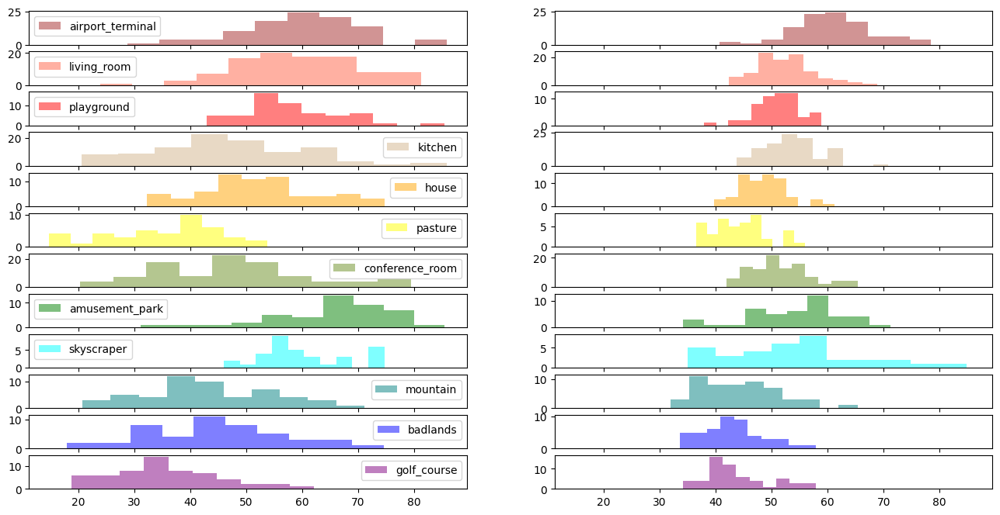

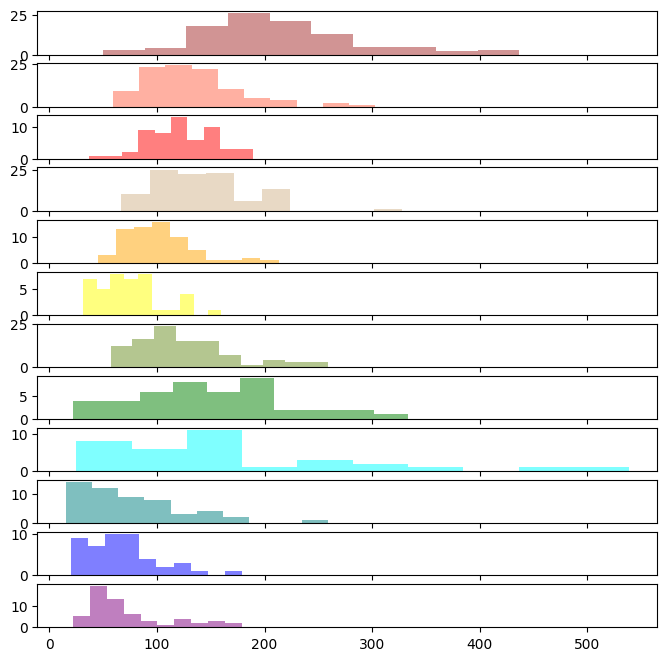

In [51]:
cats = ['airport_terminal', 'living_room', 'playground', 'kitchen', 'house', 'pasture', 'conference_room', 
 'amusement_park', 'skyscraper', 'mountain', 'badlands', 'golf_course']

fig, axes = plt.subplots(len(cats), 2, figsize=(16, 8), sharex=True)

model = linear_model.LinearRegression()
model.fit(x.to_numpy().reshape(-1, 1), y)
data['visc']['preds'] = model.predict(x.to_numpy().reshape(-1, 1))

for i, c in enumerate(cats):
    df = data['visc'][data['visc']['category'] == c]
    axes[i][0].hist(df["complexity_clean"], bins=10, alpha=0.5, label=c, color=colors[i])
    axes[i][0].legend(loc='best')
    axes[i][1].hist(df["preds"], bins=10, alpha=0.5, label=c, color=colors[i])

fig, axes = plt.subplots(len(cats), 1, figsize=(8, 8), sharex=True)

for i, c in enumerate(cats):
    df = data['visc'][data['visc']['category'] == c]
    axes[i].hist(df["64points"], bins=10, alpha=0.5, label=c, color=colors[i])

In [54]:
df = data['visc'][data['visc']['category'].isin(
    ['living_room', 'playground', 'kitchen', 'house', 'pasture', 'conference_room', 
    'amusement_park', 'mountain']
)]

get_correlations(sqrt_xform(df['64points']), df['complexity_clean']);

0.56 0.55 0.31


airport_terminal: 
0.40 0.28 0.16
living_room: 
0.47 0.49 0.22
playground: 
0.41 0.38 0.17
kitchen: 
0.77 0.73 0.60
house: 
0.47 0.53 0.22
pasture: 
0.36 0.40 0.13
conference_room: 
0.63 0.61 0.40
amusement_park: 
0.52 0.45 0.27
skyscraper: 
0.06 -0.07 0.00
mountain: 
0.48 0.47 0.23
badlands: 
0.24 0.26 0.06
golf_course: 
0.53 0.52 0.28


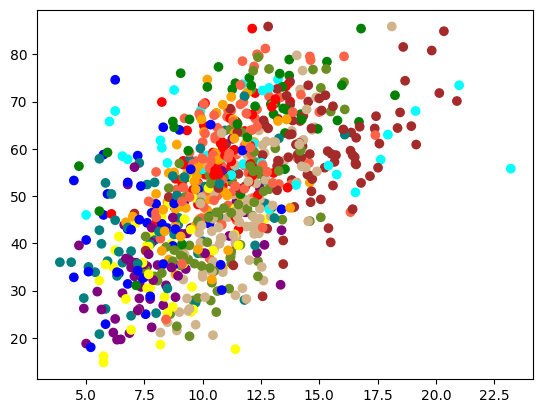

In [38]:
cats = ['airport_terminal', 'living_room', 'playground', 'kitchen', 'house', 'pasture', 'conference_room', 
 'amusement_park', 'skyscraper', 'mountain', 'badlands', 'golf_course']
plt.scatter(x, y, c=data['visc']['category'].map({k: v for k, v in zip(cats, colors[:len(cats)])}))
for c in cats:
    df = data['visc'][data['visc']['category'] == c]
    print('{}: '.format(c))
    get_correlations(sqrt_xform(df['64points']), df['complexity_clean'])
    # get_correlations(sqrt_xform(df['num_unique_classes']), df['complexity_clean'])
    # get_correlations(sqrt_xform(df['num_classes']), df['complexity_clean'])

big: 
0.40 0.28 0.16
0.03 -0.02 0.00
0.17 0.12 0.03
living_room: 
0.47 0.49 0.22
0.39 0.37 0.15
0.40 0.43 0.16
public_ent: 
0.51 0.49 0.26
0.07 0.08 0.00
0.24 0.21 0.06
kitchen: 
0.77 0.73 0.60
0.59 0.60 0.34
0.65 0.63 0.43
work_home: 
0.32 0.38 0.10
-0.04 -0.02 0.00
0.01 0.02 0.00
populated: 
0.46 0.47 0.21
0.27 0.24 0.07
0.32 0.36 0.10
small: 
0.63 0.61 0.40
0.48 0.45 0.23
0.52 0.46 0.28
isolated: 
0.37 0.37 0.14
0.15 0.17 0.02
0.14 0.17 0.02


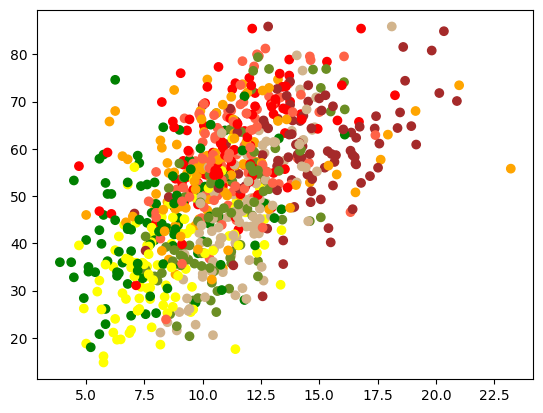

In [58]:
cats = ['big', 'living_room', 'public_ent', 'kitchen', 'work_home',
       'populated', 'small', 'isolated']
plt.scatter(x, y, c=data['visc']['category2'].map({k: v for k, v in zip(cats, colors[:len(cats)])}))
for c in cats:
    df = data['visc'][data['visc']['category2'] == c]
    print('{}: '.format(c))
    get_correlations(sqrt_xform(df['64points']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_unique_classes']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_classes']), df['complexity_clean'])

public: 
0.62 0.64 0.38
0.27 0.28 0.08
0.30 0.31 0.09
private: 
0.50 0.46 0.25
0.48 0.44 0.23
0.53 0.52 0.28
man_made: 
0.41 0.46 0.17
0.05 0.06 0.00
0.21 0.17 0.05
natural: 
0.36 0.37 0.13
0.01 0.01 0.00
0.01 0.01 0.00


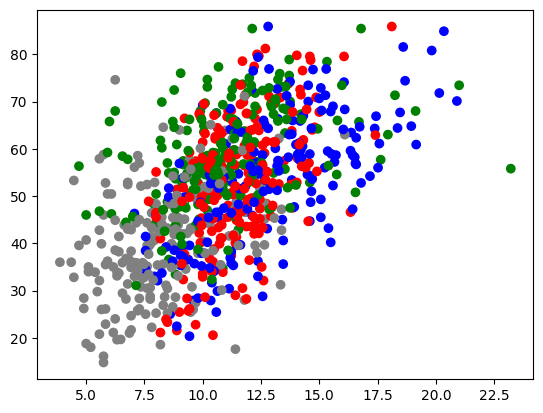

In [59]:
cats = ['public', 'private', 'man_made', 'natural']
plt.scatter(x, y, c=data['visc']['category3'].map({k: v for k, v in zip(cats, ["blue", "red", "green", "gray"])}))
for c in cats:
    df = data['visc'][data['visc']['category3'] == c]
    print('{}: '.format(c))
    get_correlations(sqrt_xform(df['64points']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_unique_classes']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_classes']), df['complexity_clean'])

indoor: 
0.55 0.55 0.30
0.32 0.31 0.11
0.40 0.38 0.16
outdoor: 
0.58 0.60 0.33
0.31 0.30 0.10
0.33 0.29 0.11


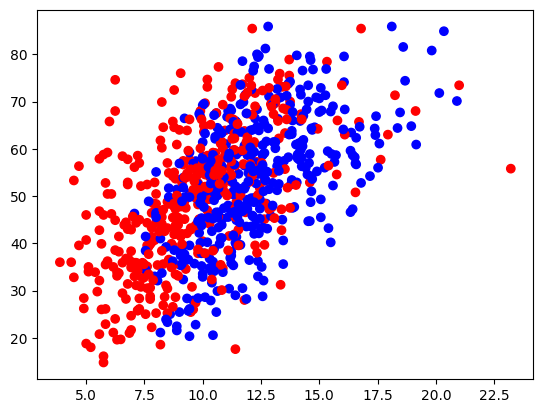

In [60]:
cats = ['indoor', 'outdoor']
plt.scatter(x, y, c=data['visc']['category4'].map({k: v for k, v in zip(cats, ["blue", "red"])}))
for c in cats:
    df = data['visc'][data['visc']['category4'] == c]
    print('{}: '.format(c))
    get_correlations(sqrt_xform(df['64points']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_unique_classes']), df['complexity_clean'])
    get_correlations(sqrt_xform(df['num_classes']), df['complexity_clean'])

In [130]:
def show_outliers(x, y, df, N=10):
    outliers = {}

    # f = np.poly1d(np.polyfit(x, y, 1))

    model = linear_model.LinearRegression()
    model.fit(x, y)
    df['pred'] = model.predict(x)

    df['target'] = y
    # df['pred'] = f(x)
    df['diff'] = df['target'] - df['pred']
    df['numseg_rank'] = rank_transform(df['64points'])
    df['numclass_rank'] = rank_transform(df['num_unique_classes'])

    outliers['overestimated'] = df.sort_values(['diff'], ascending=True)
    outliers['underestimated'] = df.sort_values(['diff'], ascending=False)
    outliers['accurate'] = df.sort_values(by=['diff'], key=abs, ascending=True)

    for k in ["overestimated", "underestimated", "accurate"]:

        print("\n\n\n\n========================== {} ==========================\n\n\n\n".format(k))

        for i in range(N):
            row = outliers[k].iloc[i]
            fname = row['filename']
            image1 = Image(filename="/ptmp/tshen/shared/VISC/VISC-C/images/" + fname, width=300)
            image2 = Image(filename="/ptmp/tshen/shared/Results/2023July20/VISC/64points/" + fname[:-4] + ".png", width=300)
            print("Complexity: {:.1f}, Pred: {:.1f}, Num unique: {} ({}/{}) Num seg: {} ({}/{})\n{}".format(
                row["complexity"], row["pred"],
                row["num_unique_classes"], row["numclass_rank"], len(df),
                row["64points"], row["numseg_rank"], len(df), fname))
            display(image1)
            display(image2)

    return df

In [113]:
import cv2
from tqdm import tqdm

edge_density = []
for fname in tqdm(data['visc'].filename):
    image_path = "/ptmp/tshen/shared/VISC/VISC-C/images/" + fname
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, threshold1=500/3, threshold2=500)
    edge_density.append(edges.mean())

data['visc']['edge_density'] = np.array(edge_density)

100%|██████████| 800/800 [00:08<00:00, 95.30it/s] 


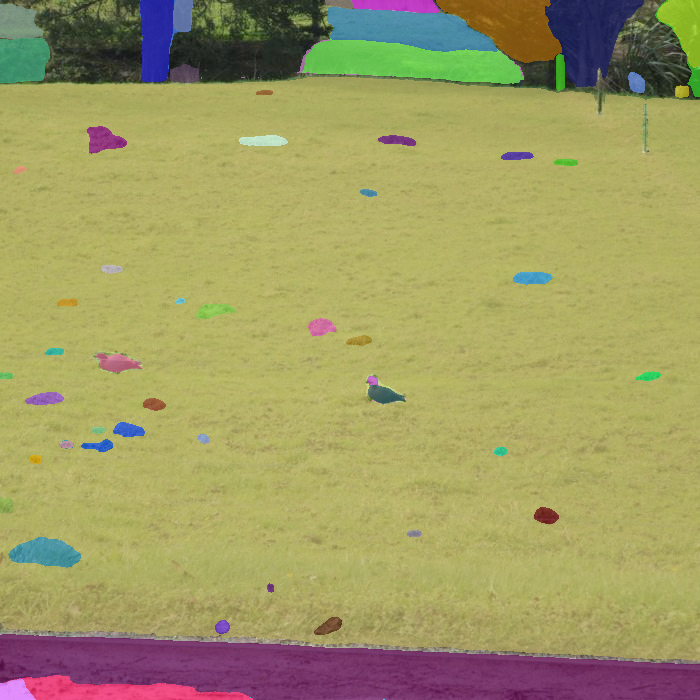

In [161]:
display(Image(filename="/ptmp/tshen/shared/Results/2023July21/VISC/64points0.92pred_iou_thresh/" + "sun_bljymfxujgbxjuvx.png", width=300))

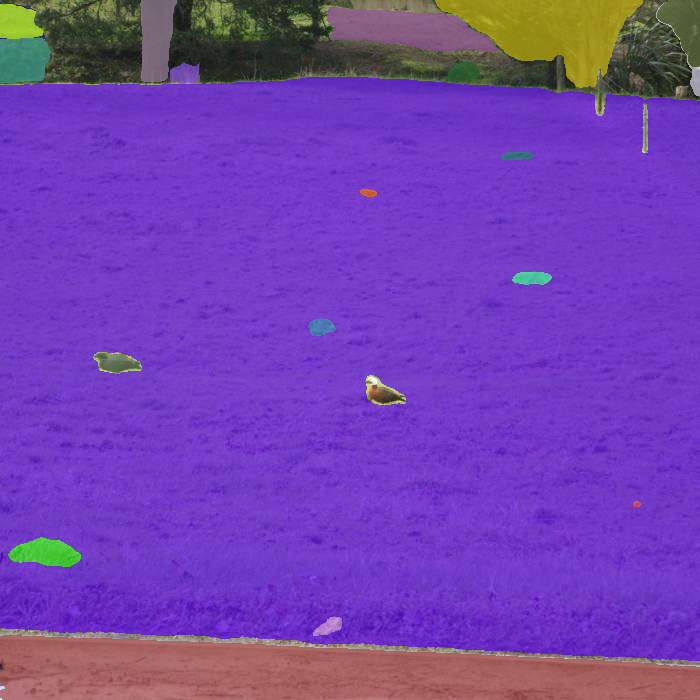

In [162]:
display(Image(filename="/ptmp/tshen/shared/Results/2023July20/VISC/16points/" + "sun_bljymfxujgbxjuvx.png", width=300))

0.64 0.64 0.41




========================== overestimated ==========================




Complexity: 21.4, Pred: 50.3, Num unique: 13 (642.5/800) Num seg: 109 (357.0/800)
sun_aizcycyyvgfcdnzp.jpg


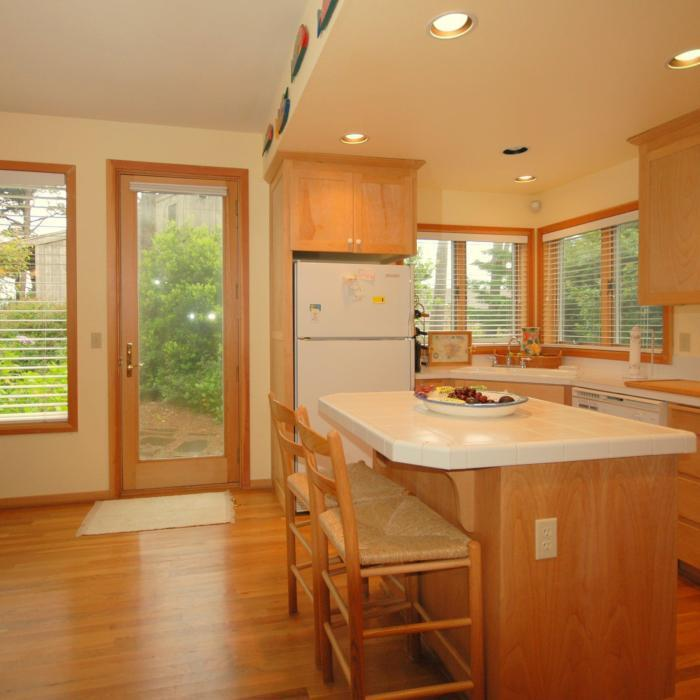

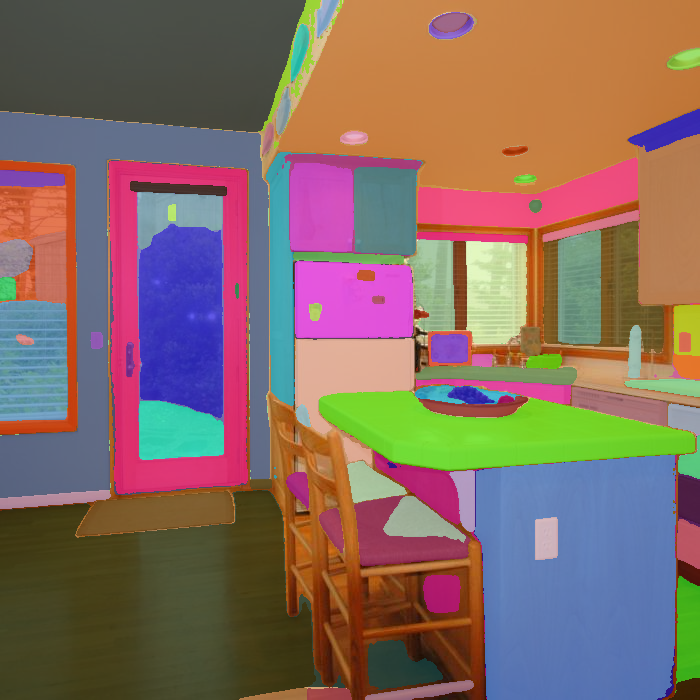

Complexity: 34.6, Pred: 61.4, Num unique: 7 (339.0/800) Num seg: 110 (364.0/800)
sun_adtwbpowivasnfgz.jpg


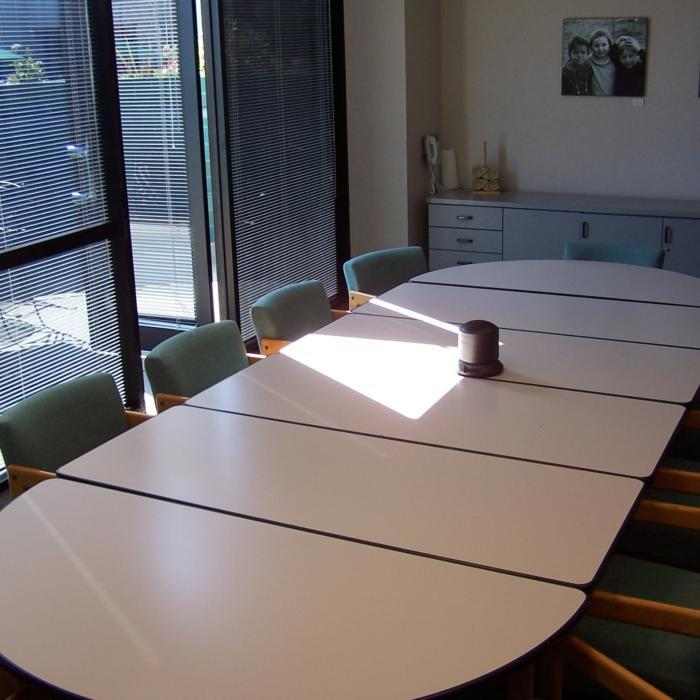

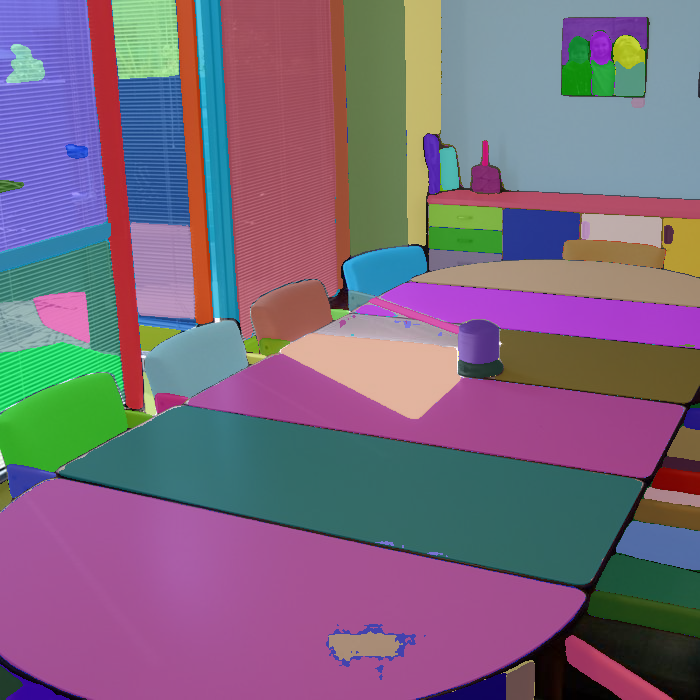

Complexity: 42.6, Pred: 66.3, Num unique: 3 (78.5/800) Num seg: 150 (567.0/800)
sun_bbduqosbteypfkil.jpg


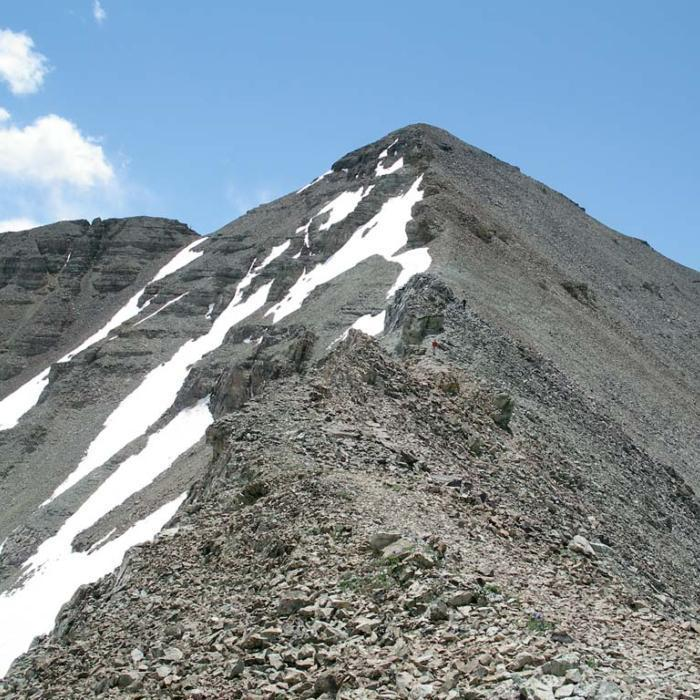

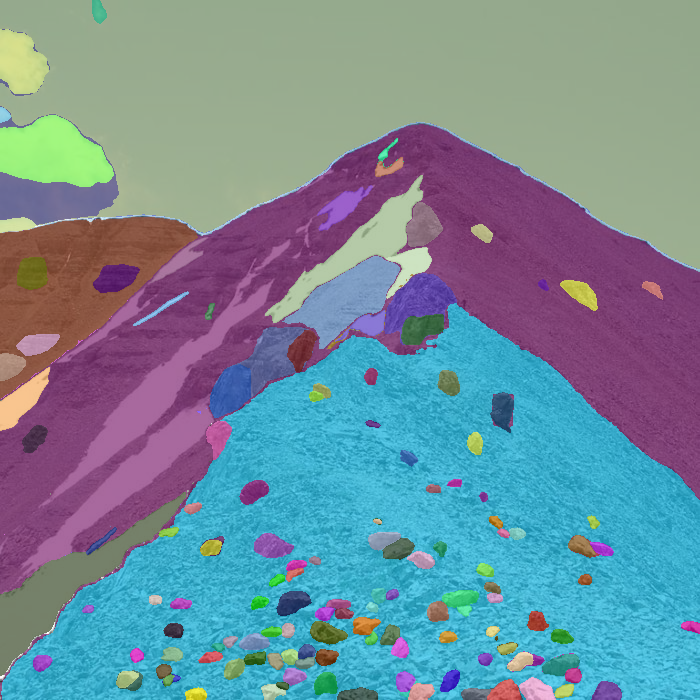

Complexity: 19.6, Pred: 46.0, Num unique: 9 (469.5/800) Num seg: 89 (246.5/800)
sun_baztjayuqhvdcxph.jpg


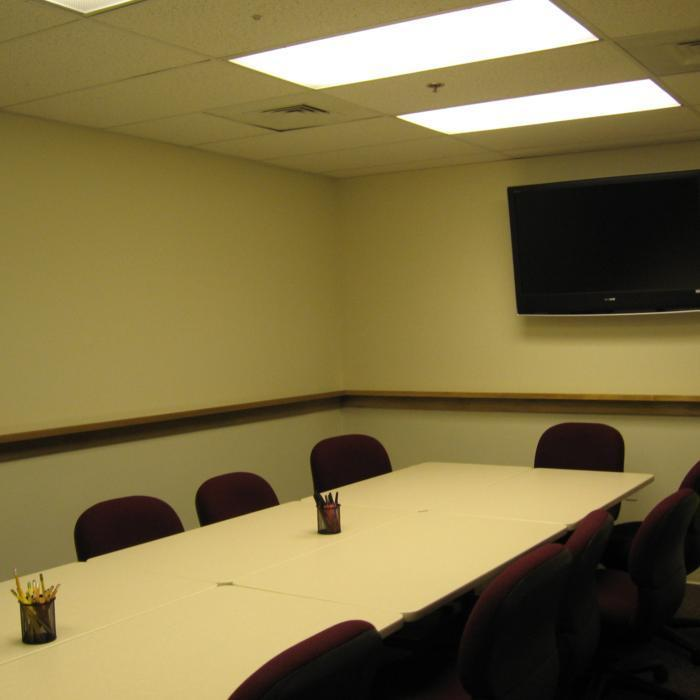

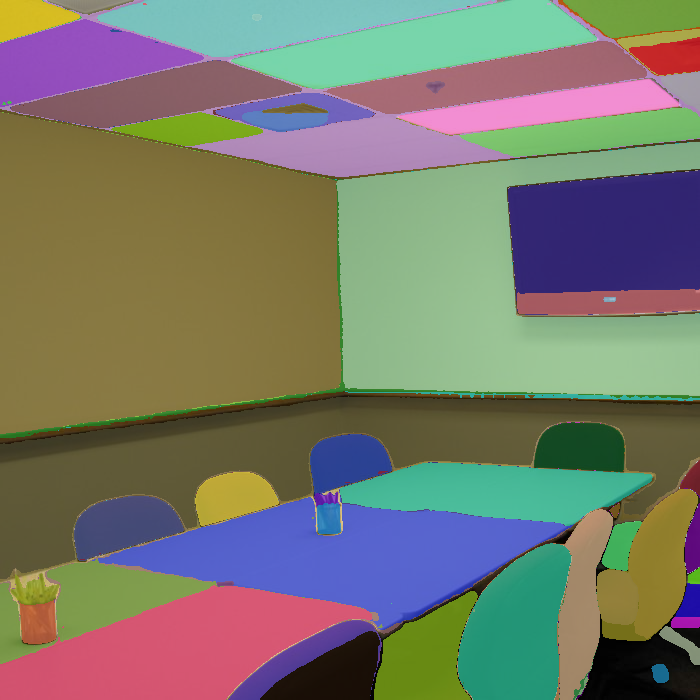

Complexity: 31.1, Pred: 54.2, Num unique: 10 (522.0/800) Num seg: 130 (472.0/800)
sun_aiwjjxhtgtrwjdsf.jpg


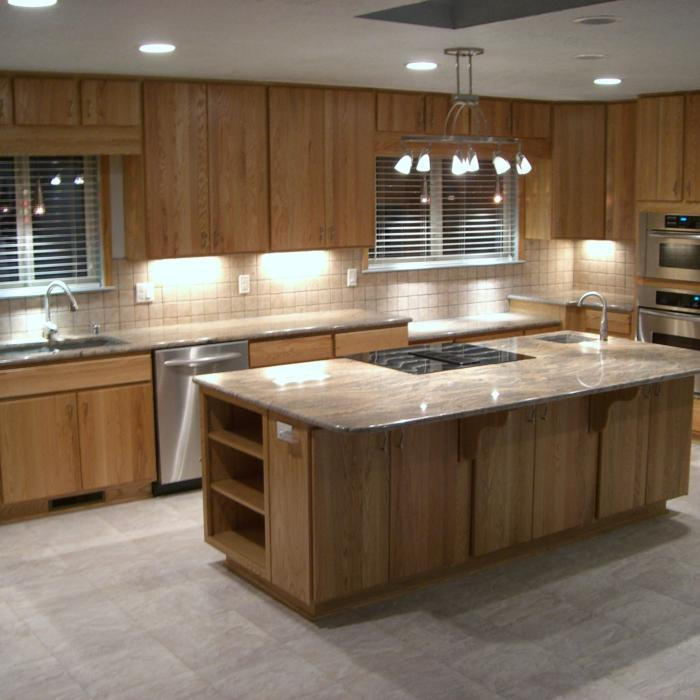

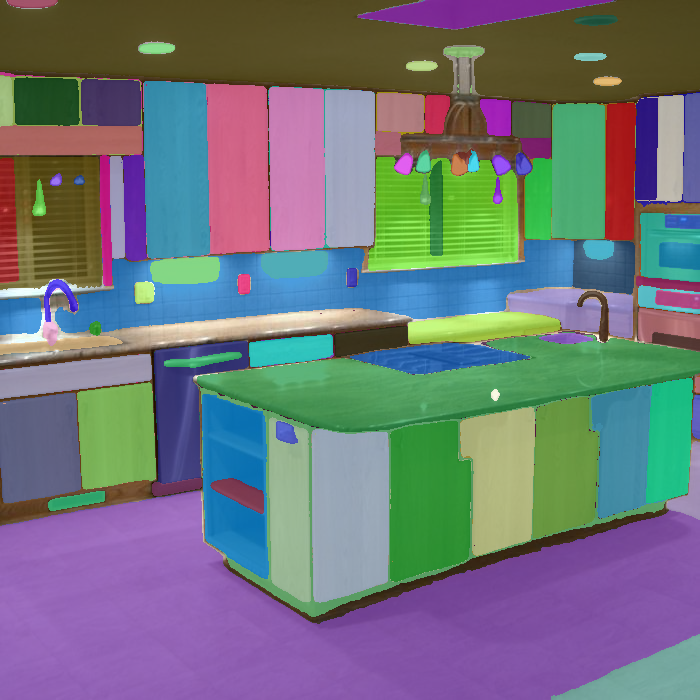





========================== underestimated ==========================




Complexity: 83.3, Pred: 56.0, Num unique: 9 (469.5/800) Num seg: 164 (618.5/800)
sun_auyvxoybsqfsxbyq.jpg


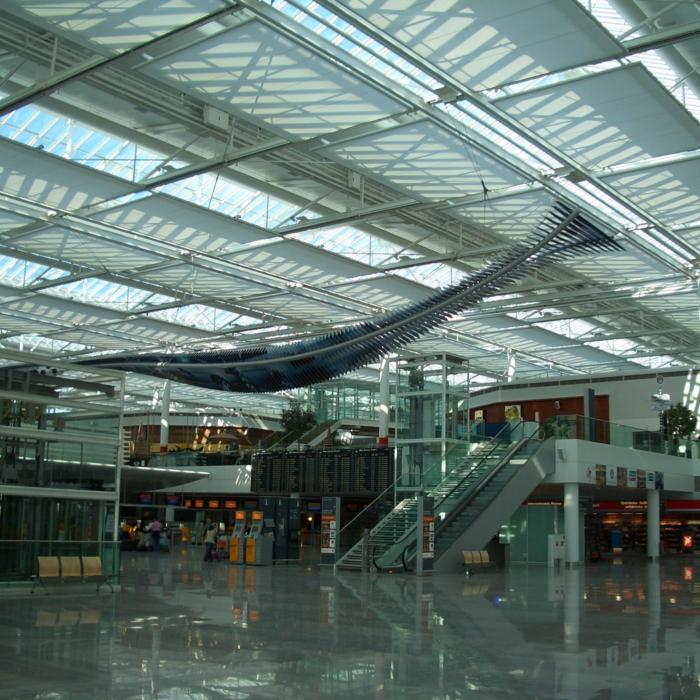

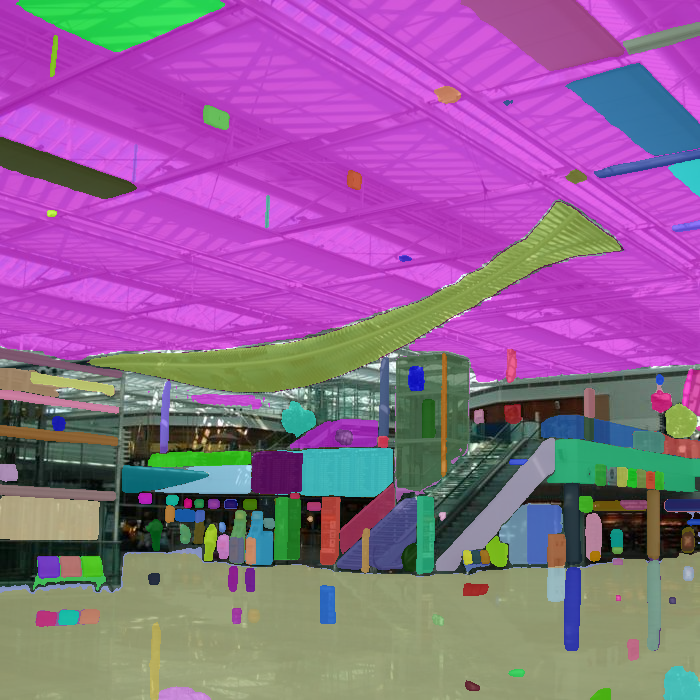

Complexity: 75.1, Pred: 44.2, Num unique: 8 (401.5/800) Num seg: 130 (472.0/800)
sun_ayalfiumstdpfnni.jpg


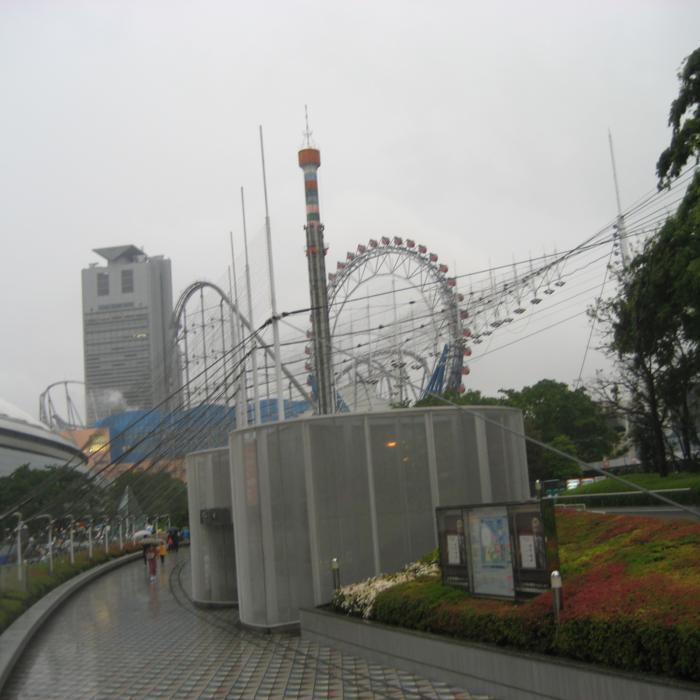

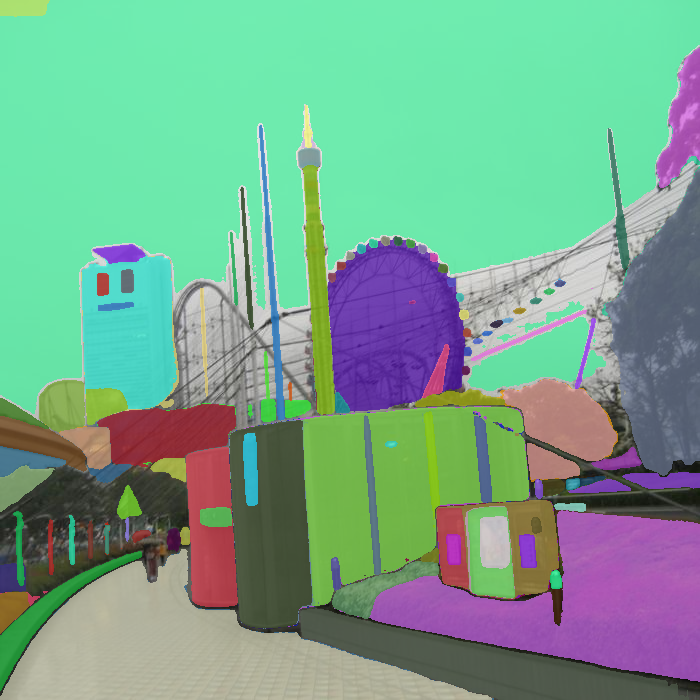

Complexity: 76.8, Pred: 49.8, Num unique: 5 (224.0/800) Num seg: 114 (388.5/800)
sun_bffqsvafmjibtkro.jpg


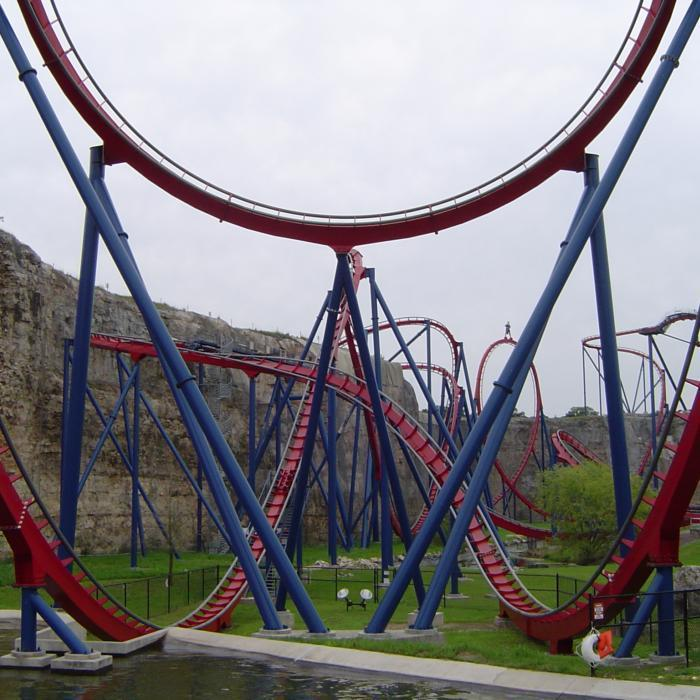

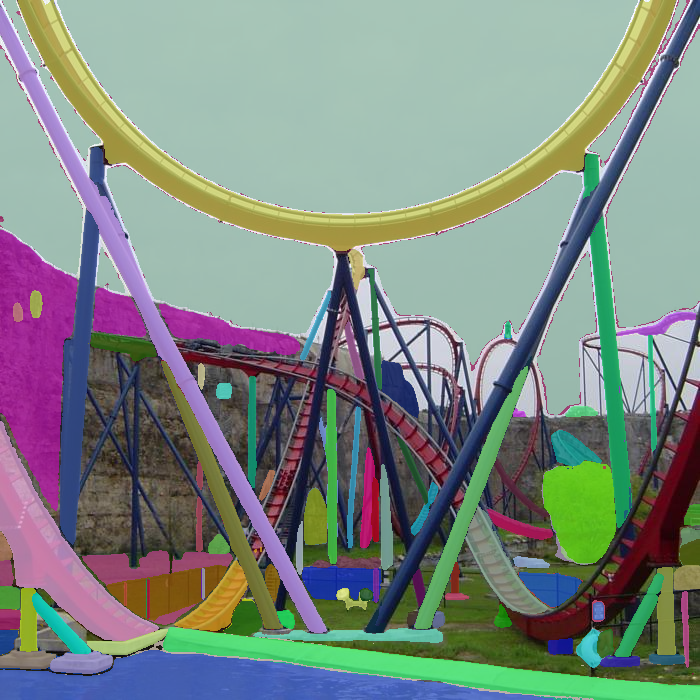

Complexity: 79.4, Pred: 53.9, Num unique: 11 (561.5/800) Num seg: 153 (580.5/800)
sun_bkkauiedynghatdc.jpg


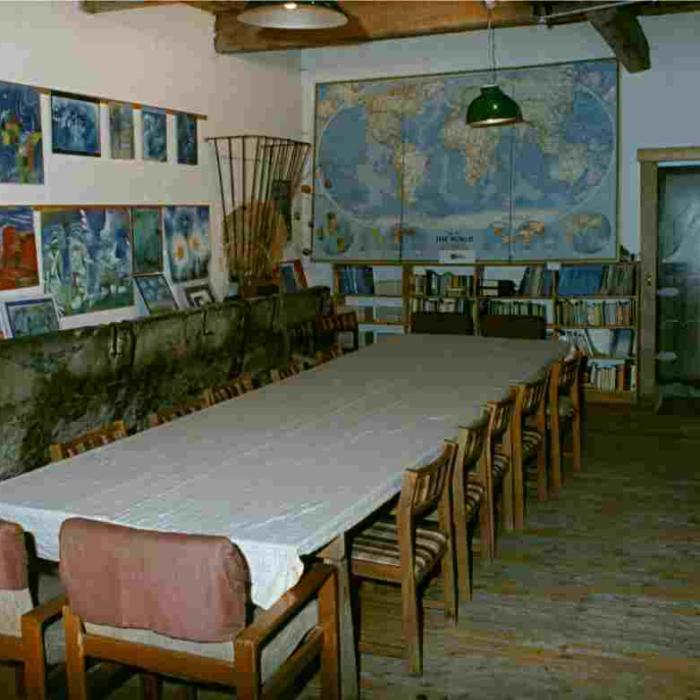

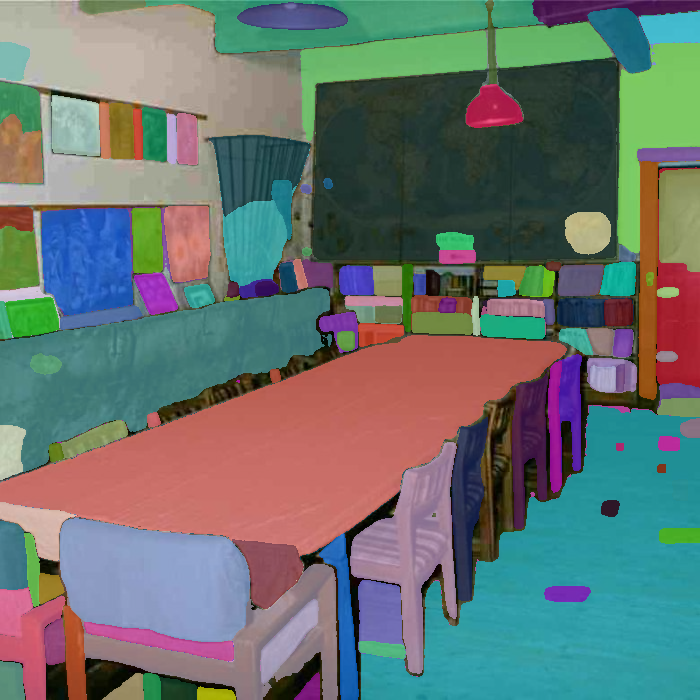

Complexity: 78.9, Pred: 56.4, Num unique: 12 (604.0/800) Num seg: 161 (611.0/800)
sun_azuyiwoejycfgxif.jpg


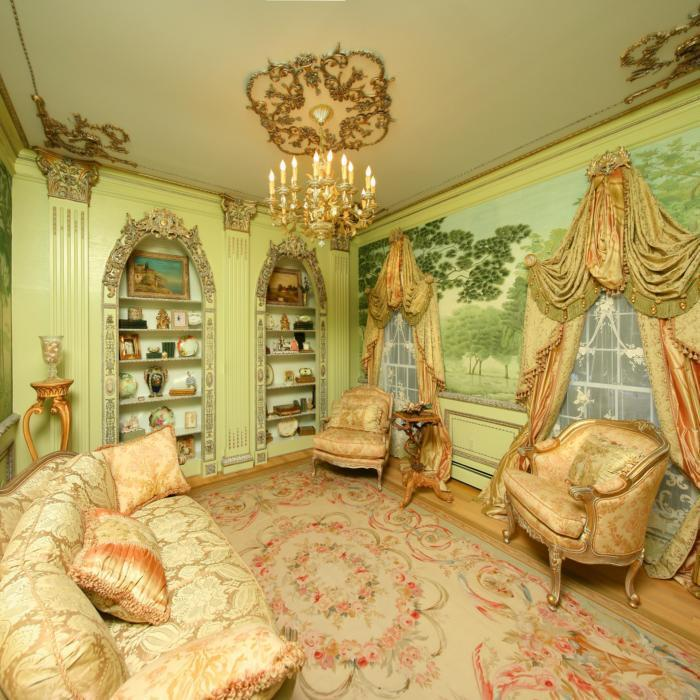

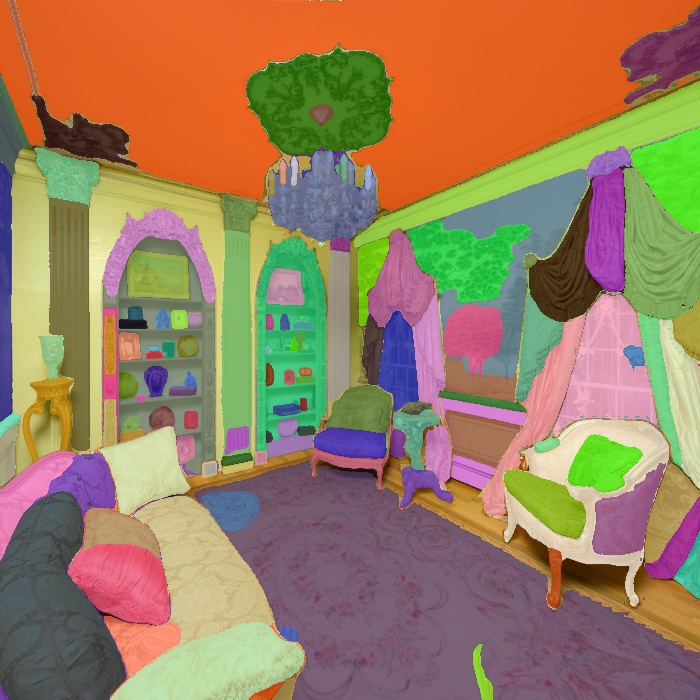





========================== accurate ==========================




Complexity: 47.7, Pred: 45.1, Num unique: 8 (401.5/800) Num seg: 160 (606.5/800)
sun_bqtreizbpeoqbpch.jpg


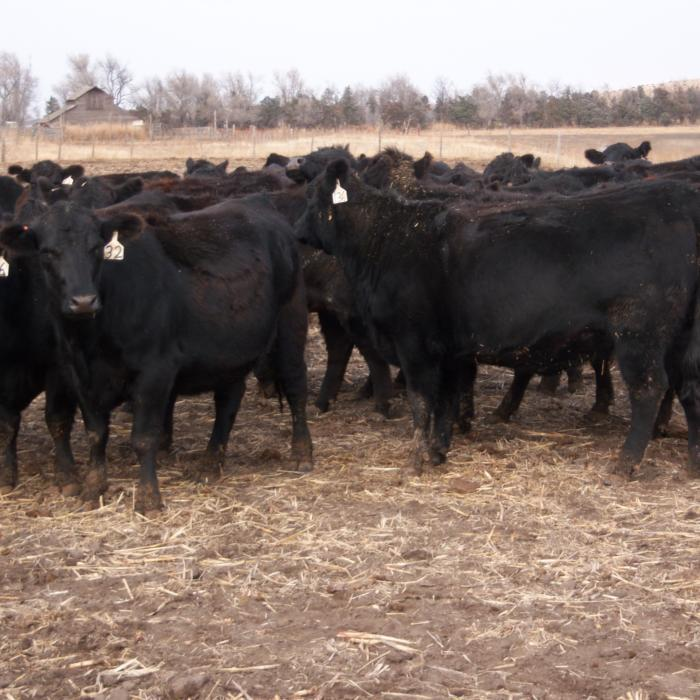

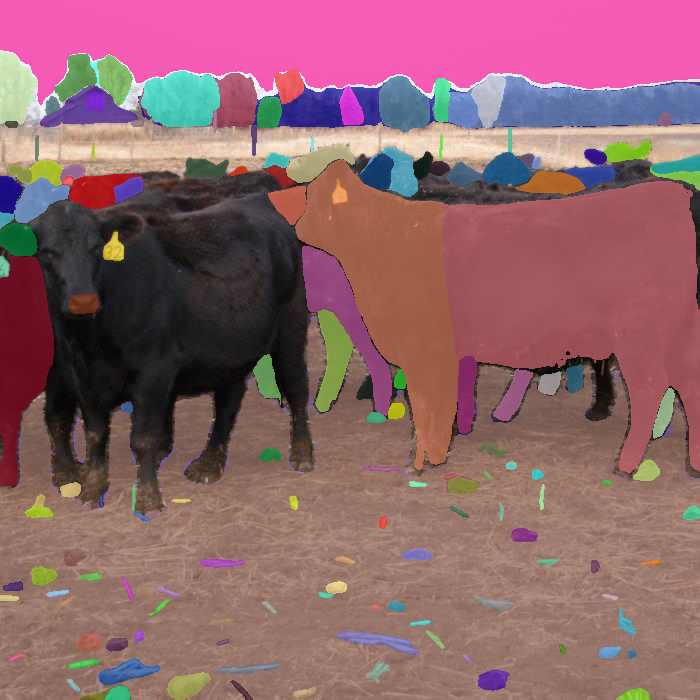

Complexity: 52.7, Pred: 53.6, Num unique: 6 (285.0/800) Num seg: 78 (188.5/800)
sun_bcqjthtjrluwygzp.jpg


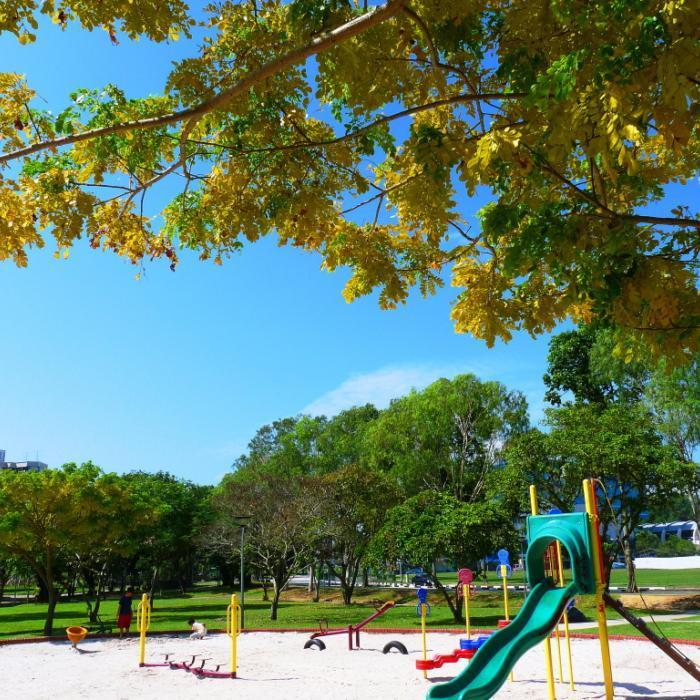

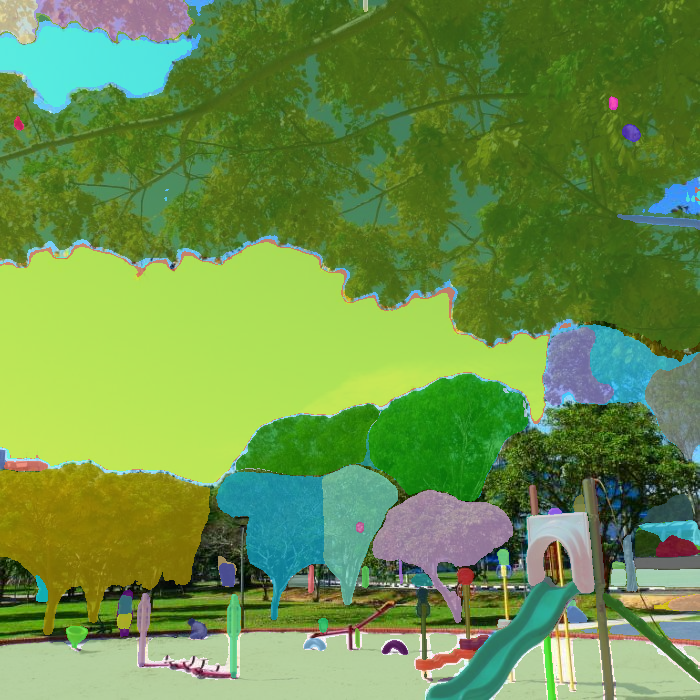

Complexity: 52.2, Pred: 54.2, Num unique: 7 (339.0/800) Num seg: 106 (338.0/800)
sun_bwgoyohsqmxbyjxg.jpg


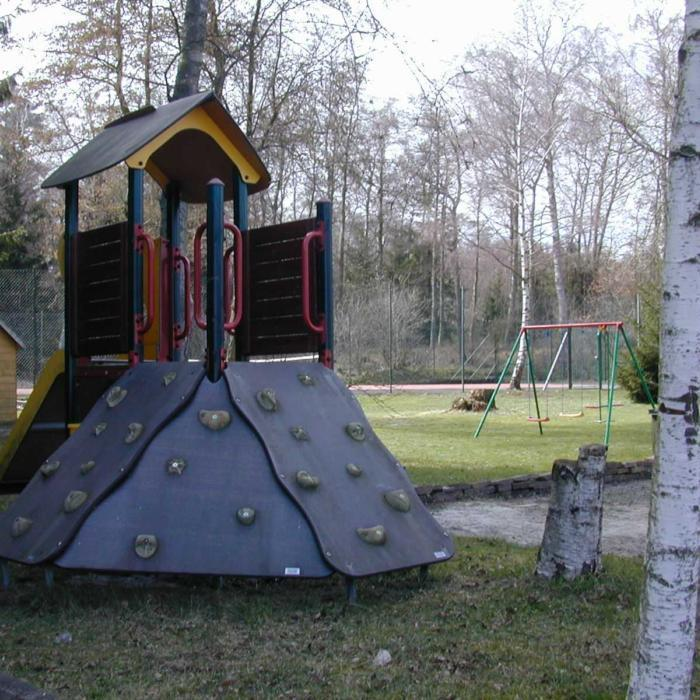

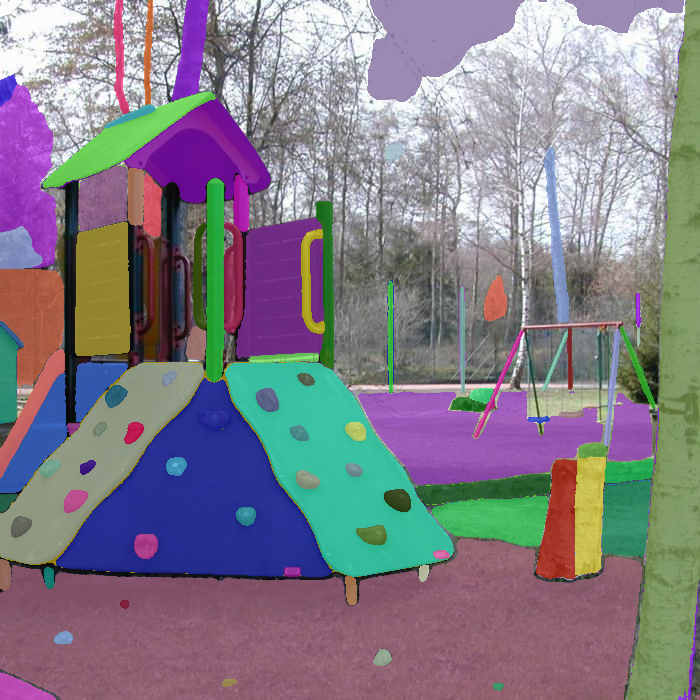

Complexity: 50.6, Pred: 51.4, Num unique: 14 (676.0/800) Num seg: 165 (622.0/800)
sun_baigtkrwgvvbtjxj.jpg


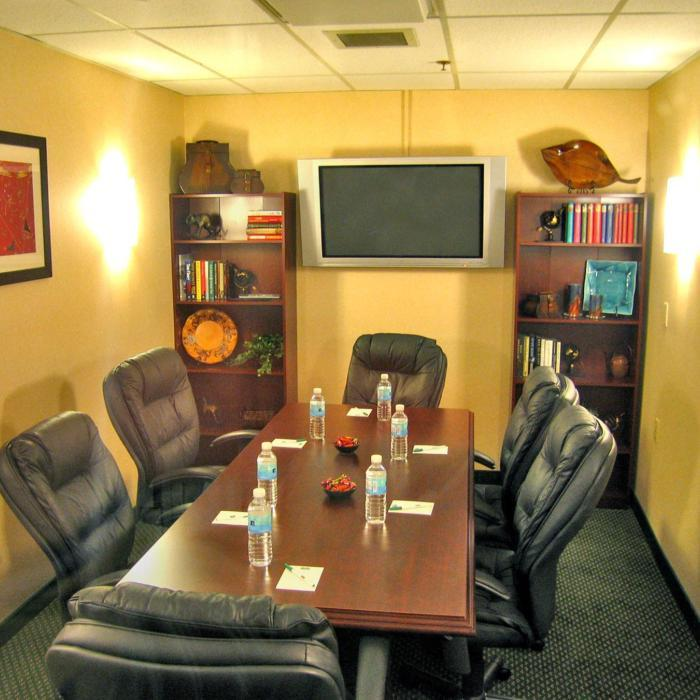

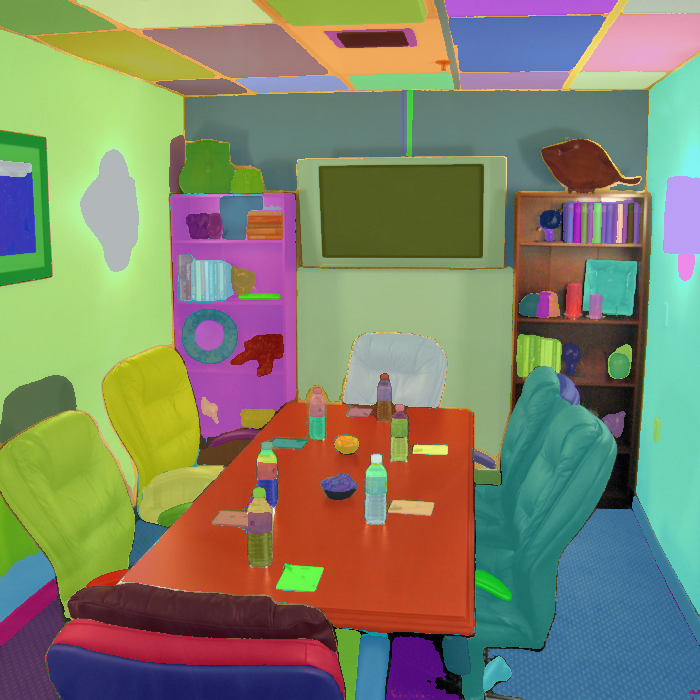

Complexity: 42.0, Pred: 39.5, Num unique: 4 (153.0/800) Num seg: 76 (173.5/800)
sun_bcwcfakrunomyxpn.jpg


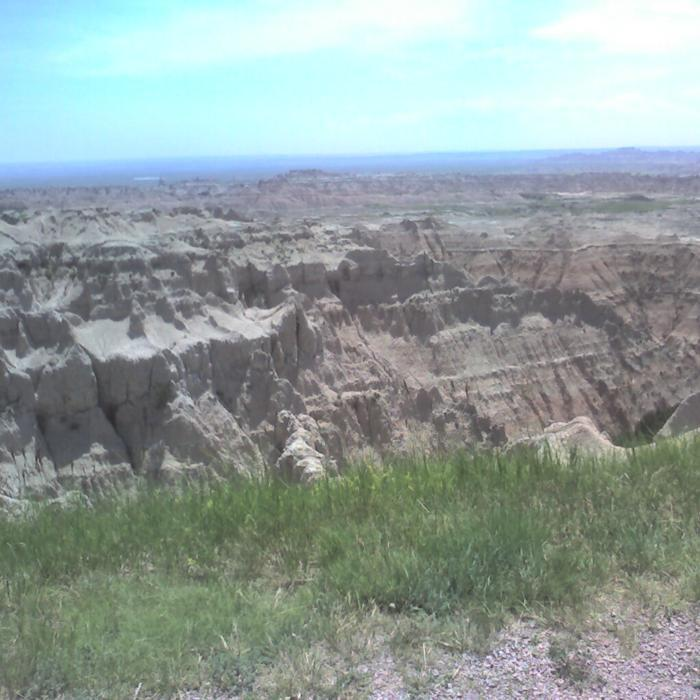

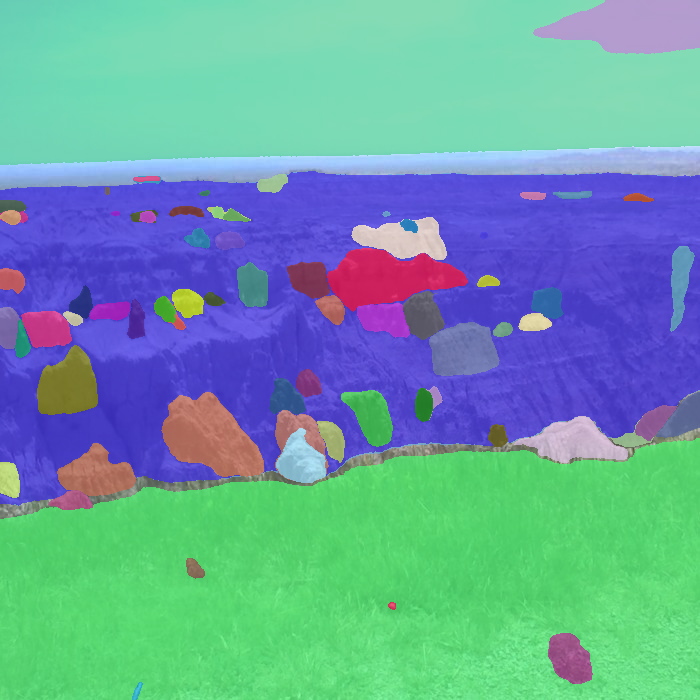

In [169]:
model = linear_model.LinearRegression()
# ['airport_terminal', 'living_room', 'playground', 'kitchen', 'house', 'pasture', 'conference_room', 
#  'amusement_park', 'skyscraper', 'mountain', 'badlands', 'golf_course']
df = data['visc'][data['visc']['category'].isin(
    ['airport_terminal', 'living_room', 'playground', 'kitchen', 'house', 'pasture', 'conference_room', 
    'amusement_park', 'skyscraper', 'mountain', 'badlands', 'golf_course']
)].copy()
x = df[["16points", "num_unique_classes", "edge_density"]]
y = df['complexity_clean']
model.fit(x, y)
get_correlations(model.predict(x), y)
df = show_outliers(x, y, df, N=5)

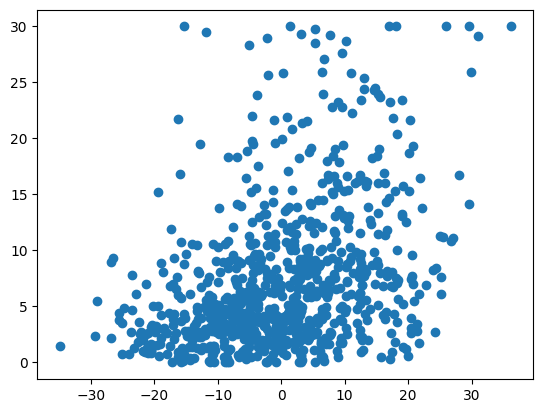

In [124]:
plt.scatter(df['diff'], np.clip(df['edge_density'], 0, 30))
# df.sort_values(['diff'], ascending=True)

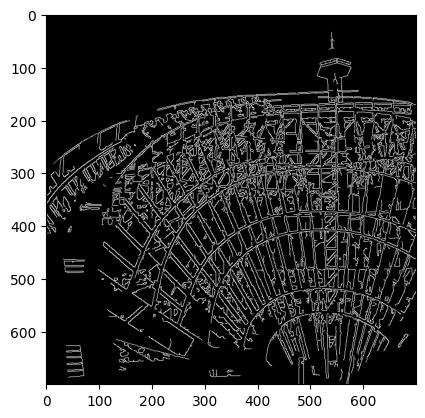

25.91788775510204

In [112]:
import cv2
image = cv2.imread("sun_baumnwsreoypvzxf.jpg")
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, threshold1=500/3, threshold2=500)
plt.imshow(edges, cmap="gray")
plt.show()
edges.mean()





========================== overestimated ==========================




Complexity: 17.6, Pred: 52.5, Num unique: 4 (153.0/800) Num seg: 130 (472.0/800)
sun_bljymfxujgbxjuvx.jpg


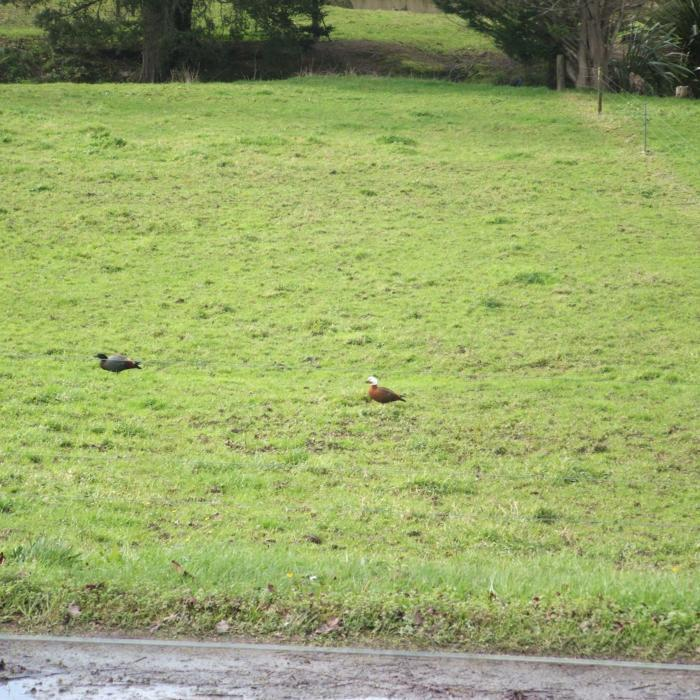

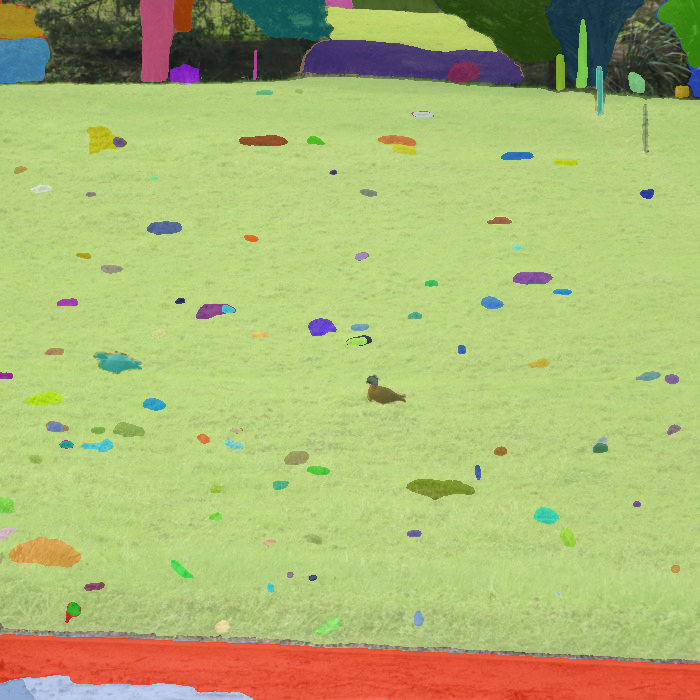

Complexity: 21.4, Pred: 49.9, Num unique: 13 (642.5/800) Num seg: 109 (357.0/800)
sun_aizcycyyvgfcdnzp.jpg


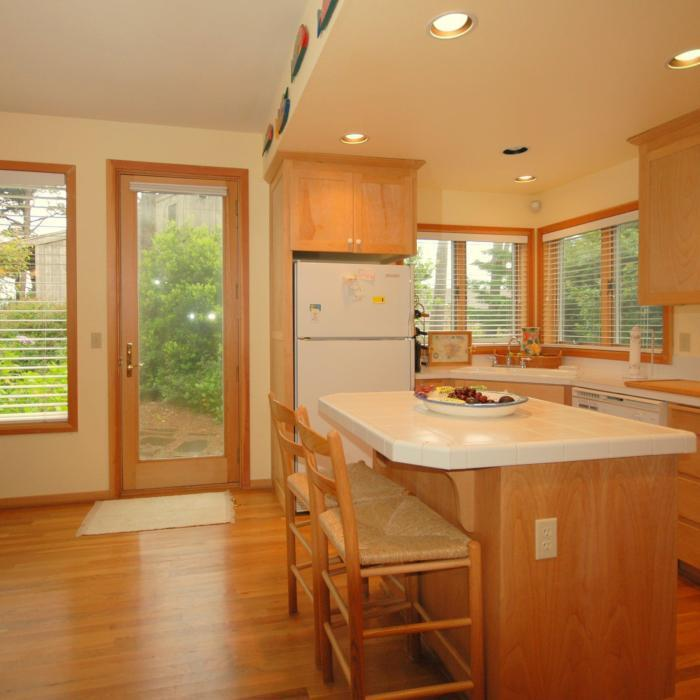

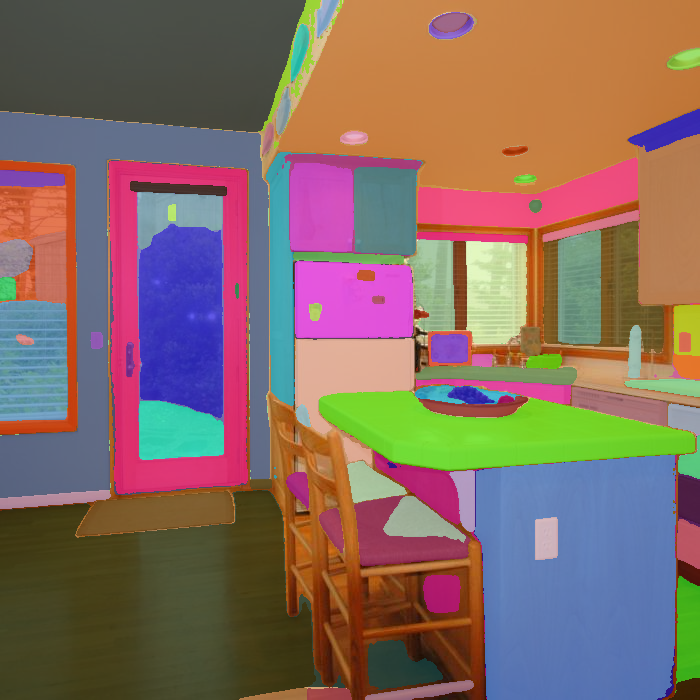

Complexity: 55.8, Pred: 84.8, Num unique: 3 (78.5/800) Num seg: 539 (800.0/800)
sun_bgshkoltnrmilxns.jpg


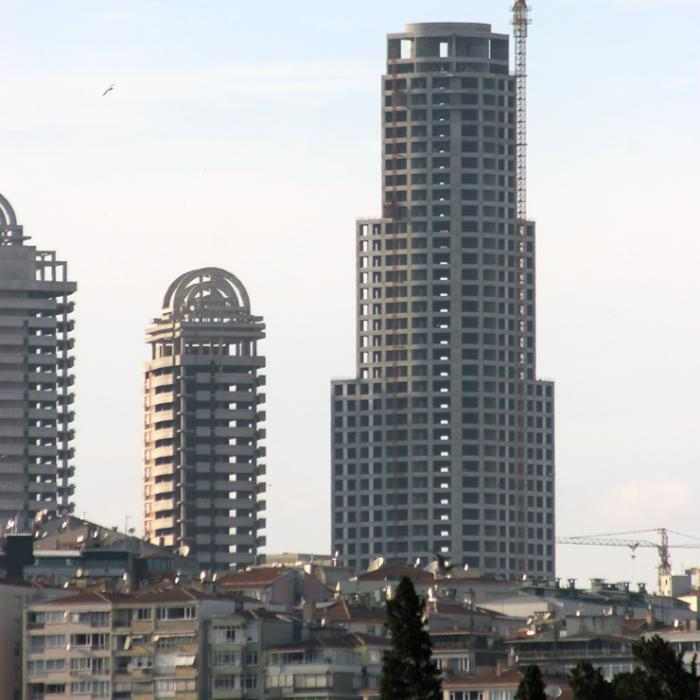

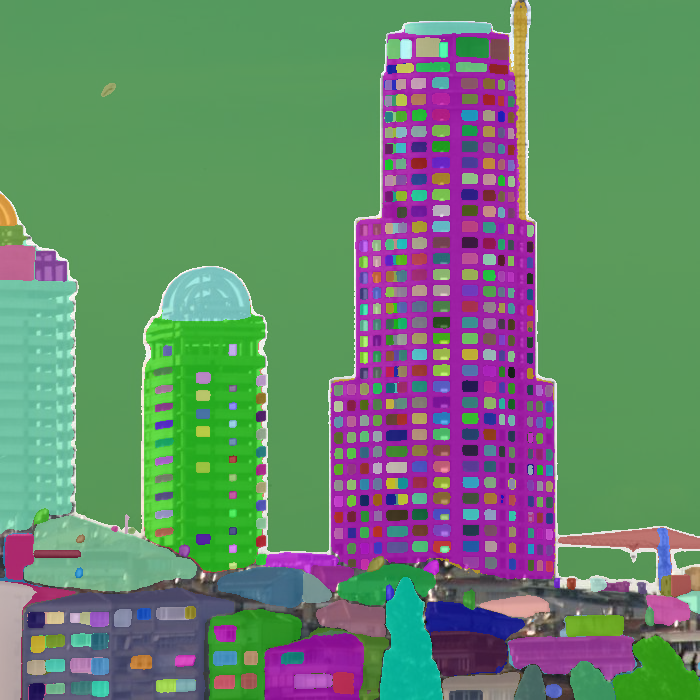





========================== underestimated ==========================




Complexity: 77.2, Pred: 38.4, Num unique: 1 (2.0/800) Num seg: 39 (42.0/800)
sun_aekkynucosyodgdj.jpg


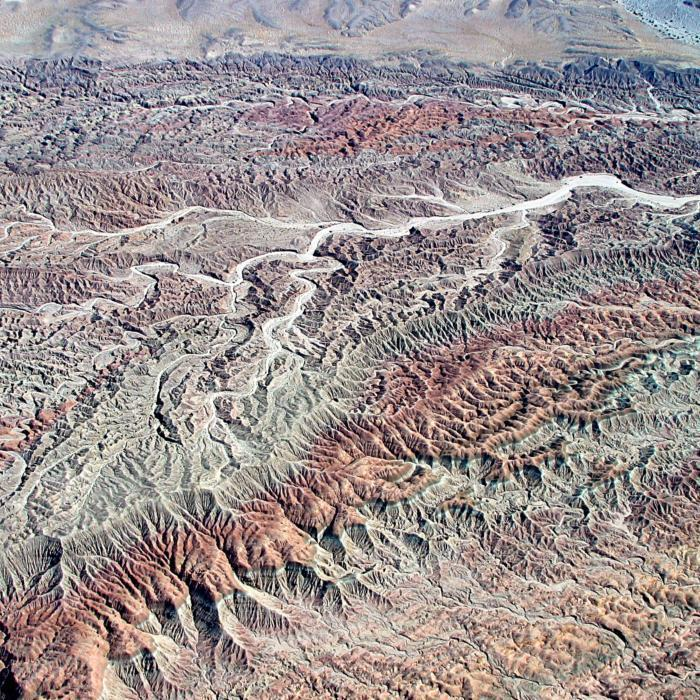

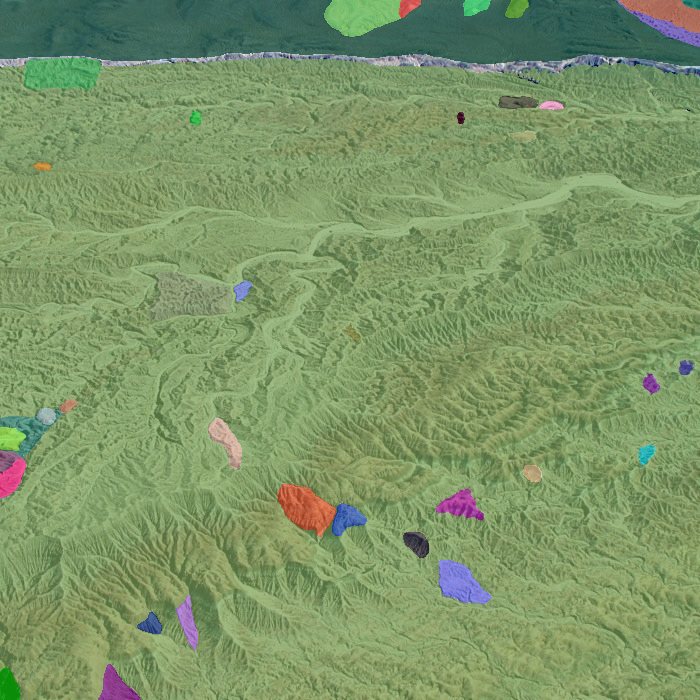

Complexity: 83.8, Pred: 54.5, Num unique: 5 (224.0/800) Num seg: 147 (550.0/800)
sun_bevxnqpoqiwuotap.jpg


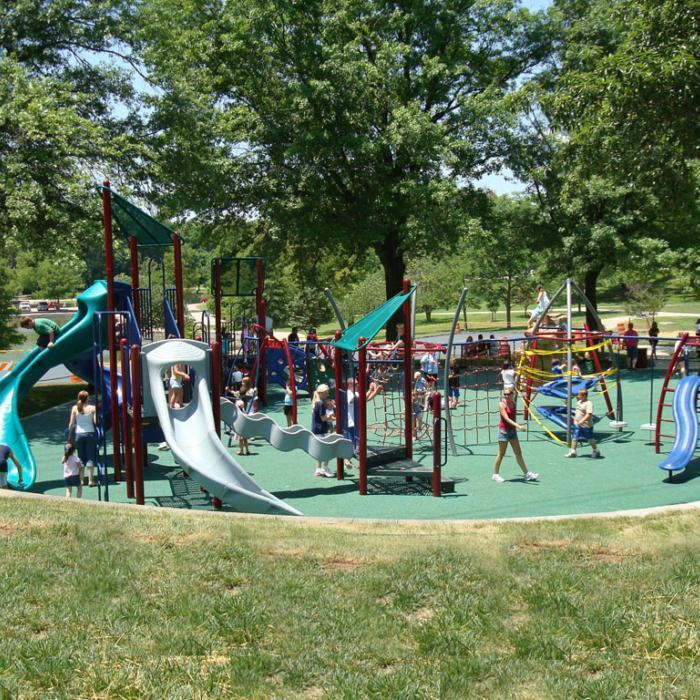

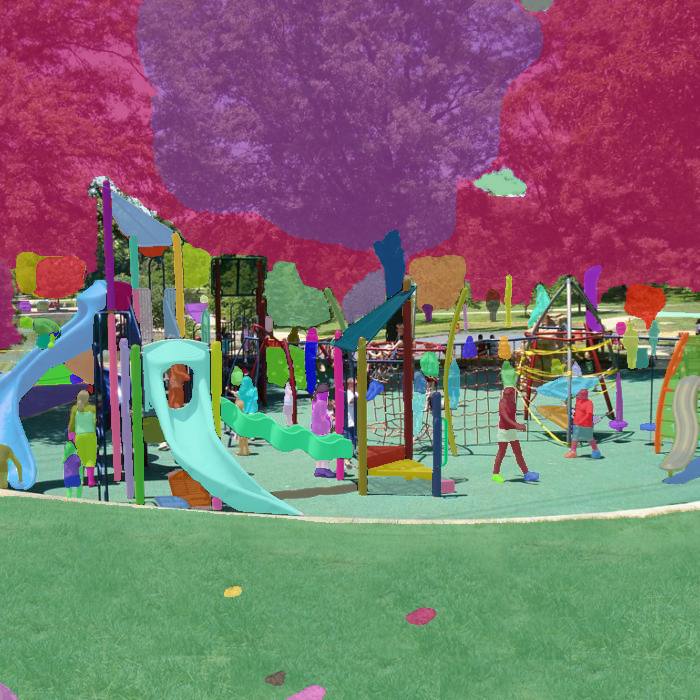

Complexity: 73.7, Pred: 46.1, Num unique: 2 (22.5/800) Num seg: 82 (208.5/800)
sun_baumnwsreoypvzxf.jpg


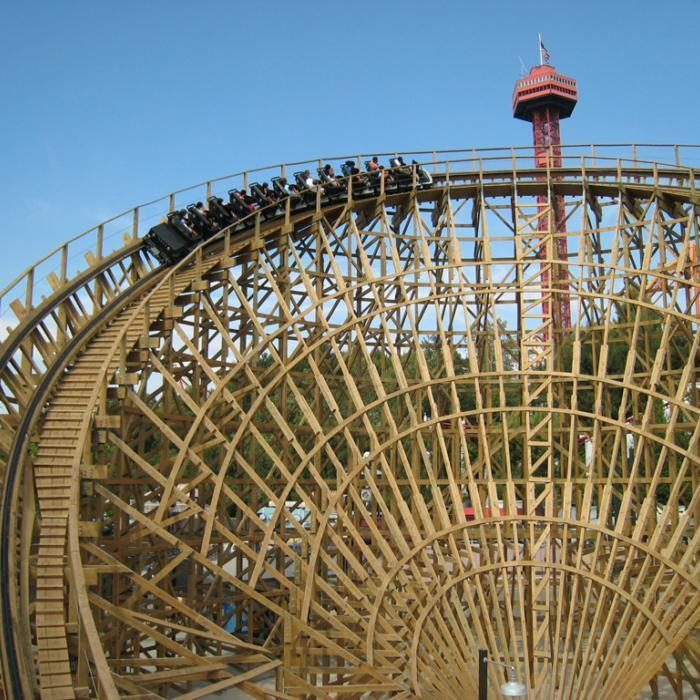

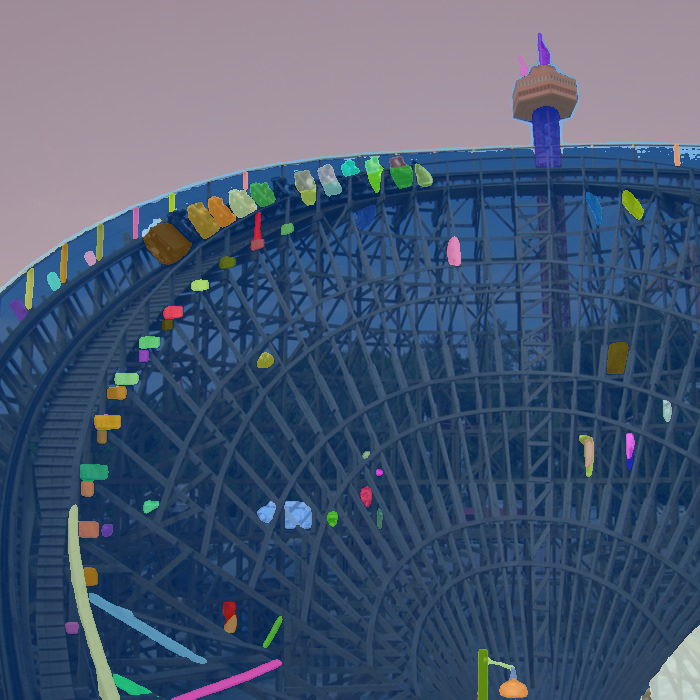





========================== accurate ==========================




Complexity: 58.0, Pred: 57.5, Num unique: 8 (401.5/800) Num seg: 175 (646.5/800)
sun_aciofoesudrskhdm.jpg


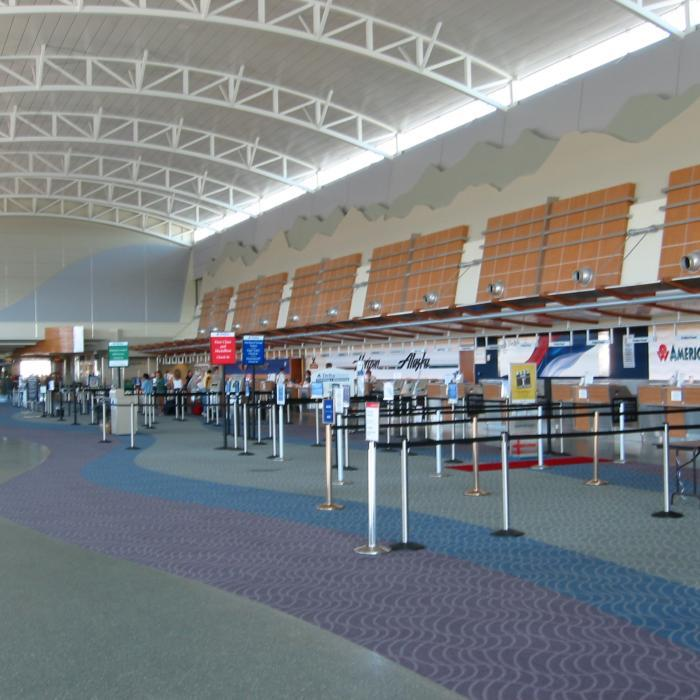

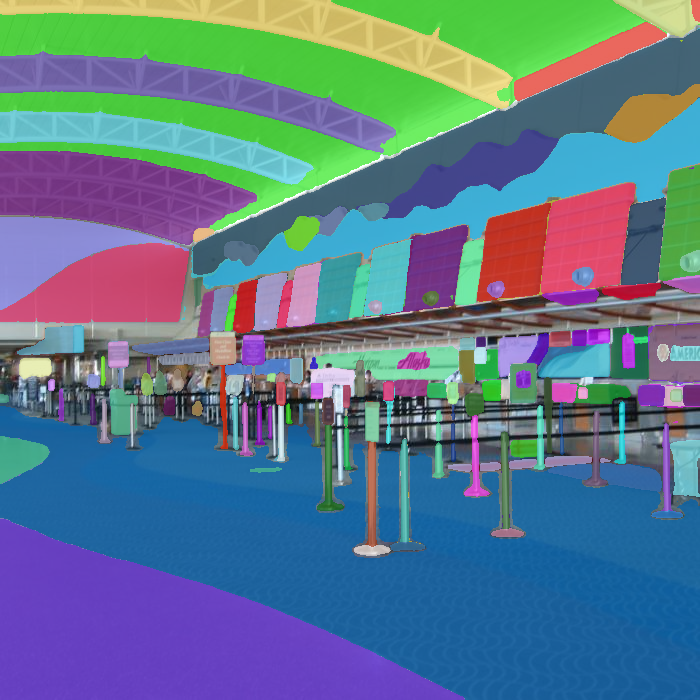

Complexity: 49.7, Pred: 49.4, Num unique: 9 (469.5/800) Num seg: 105 (332.0/800)
sun_bdlmffiaizqlxoxd.jpg


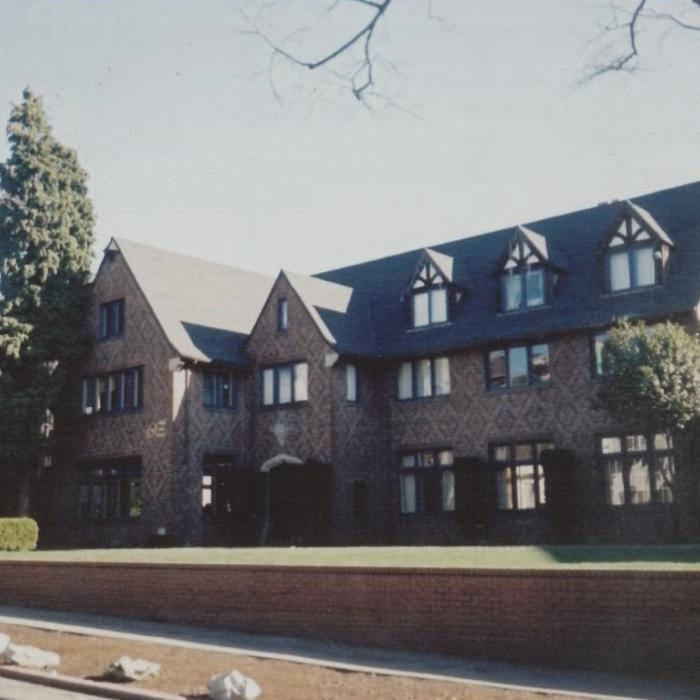

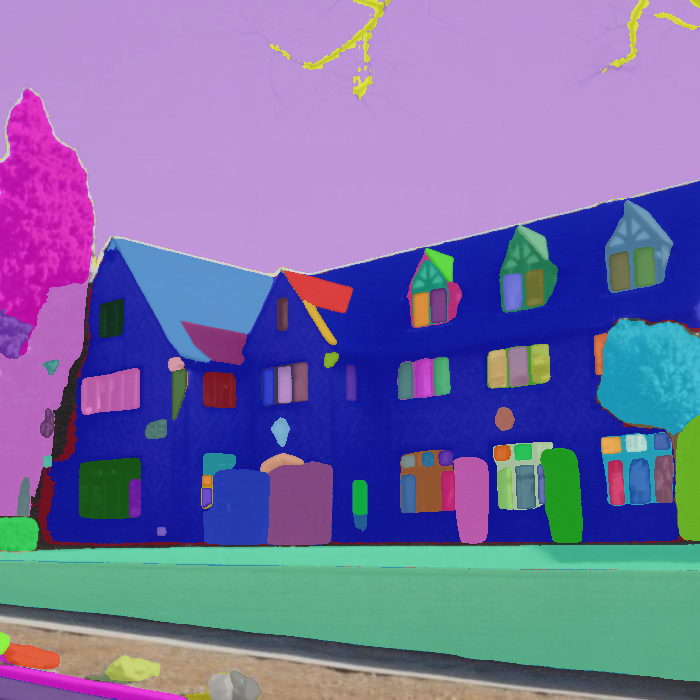

Complexity: 48.6, Pred: 48.4, Num unique: 17 (741.5/800) Num seg: 98 (290.0/800)
sun_arpxtcyqwridpafp.jpg


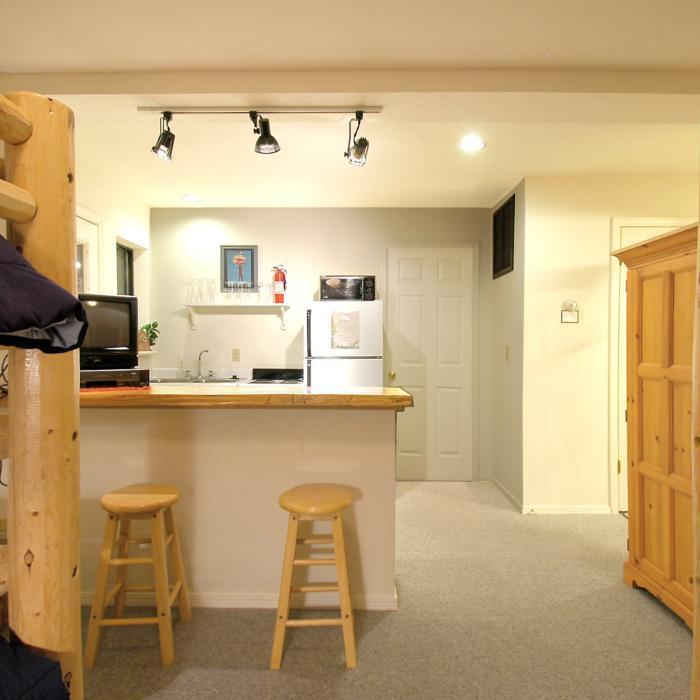

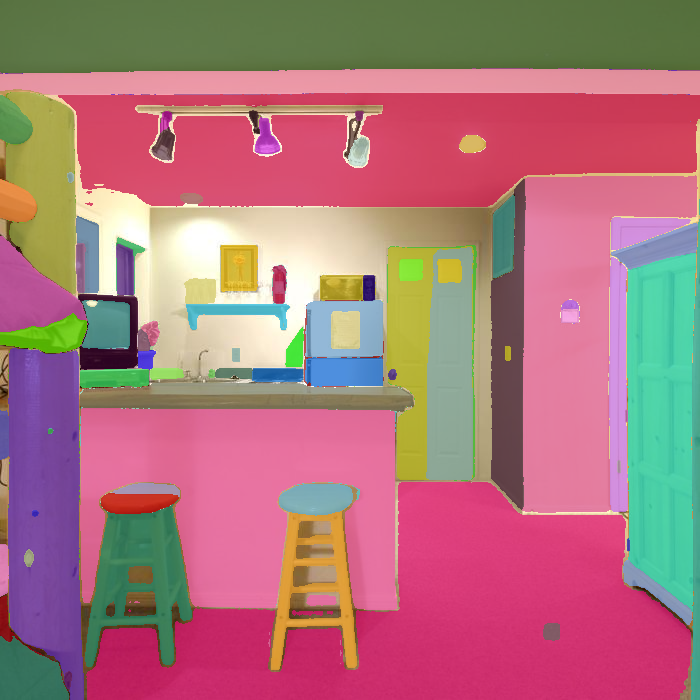

0.57 0.58 0.32


(PearsonRResult(statistic=0.5675335642259693, pvalue=2.1488638305746512e-69),
 SignificanceResult(statistic=0.579237654131026, pvalue=7.213335069783945e-73),
 0.3220943465230325)

In [138]:
df = data['visc'][['filename', '4points', '8points', '16points', '32points', '64points', 
         'complexity', 'complexity_clean', 'num_unique_classes', 'num_classes', 'edge_density']].copy()
x = sqrt_xform(df["64points"])
y = df['complexity_clean']
df = show_outliers(x.to_numpy().reshape(-1, 1), y, df, N=3)

0.47 0.49 0.22


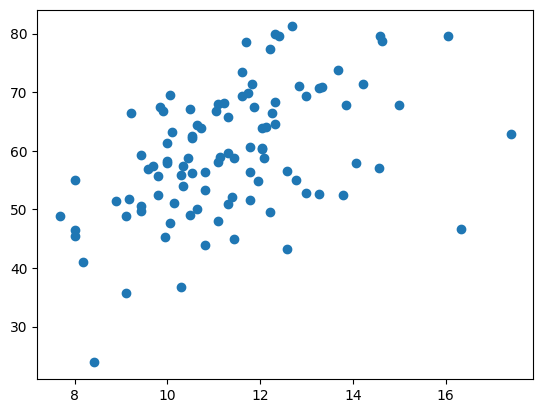





========================== overestimated ==========================




Complexity: 22.6, Pred: 51.4, Num unique: 10 (11.5/100) Num seg: 71 (6.0/100)
sun_ainzlfozoxxasyfe.jpg


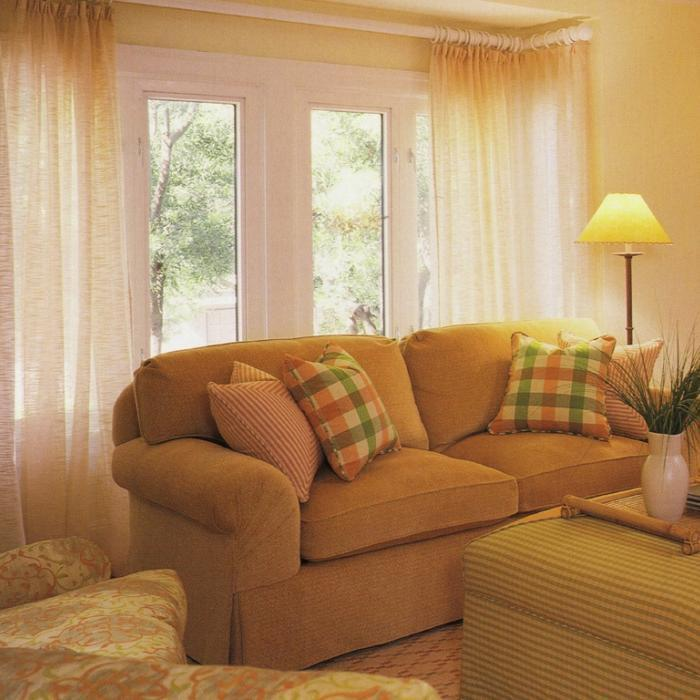

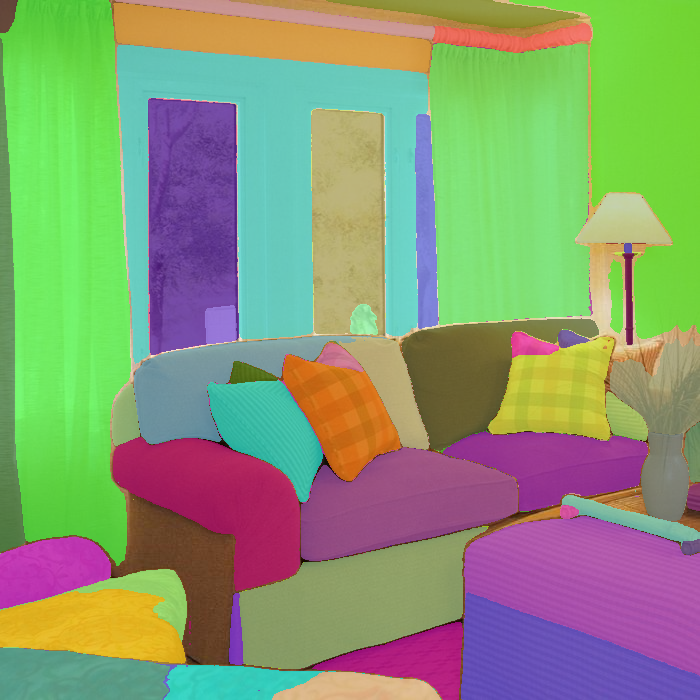

Complexity: 49.2, Pred: 73.1, Num unique: 16 (70.0/100) Num seg: 267 (99.0/100)
sun_acrjbaqsglaoxven.jpg


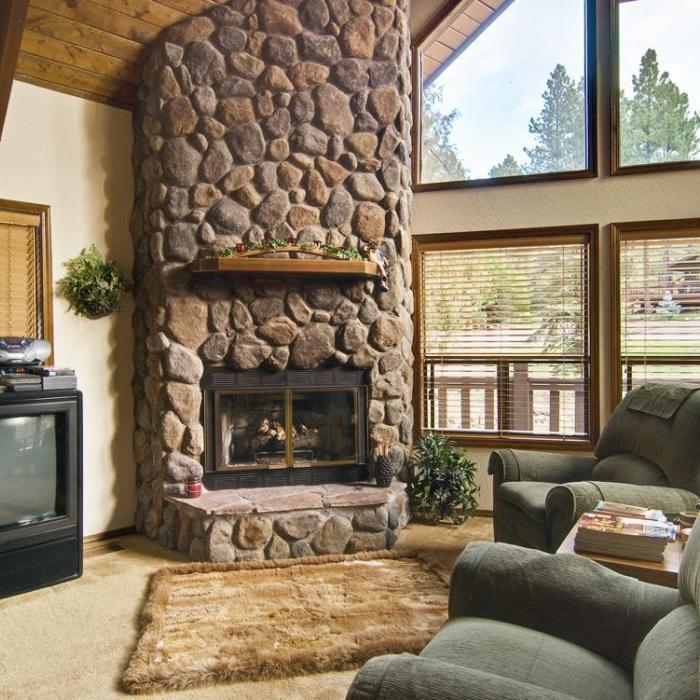

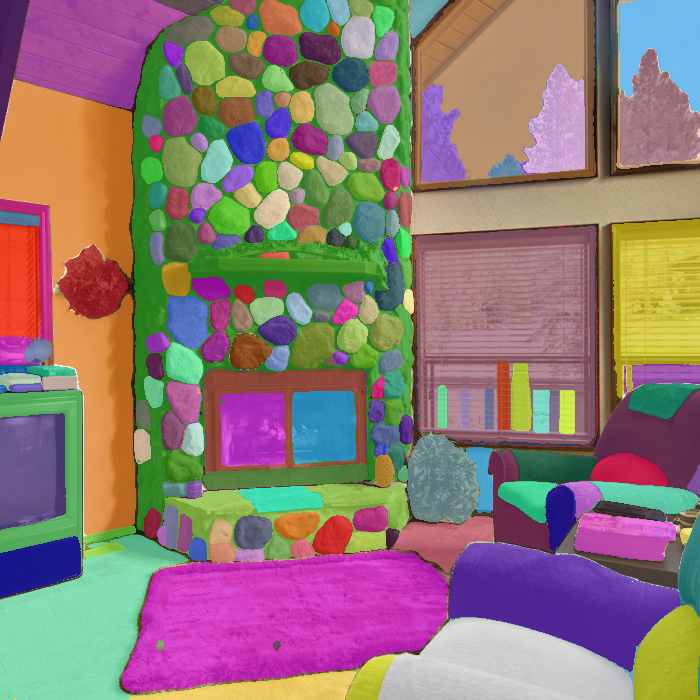

Complexity: 35.1, Pred: 56.5, Num unique: 11 (18.0/100) Num seg: 106 (29.5/100)
sun_amzkvfakckwocslk.jpg


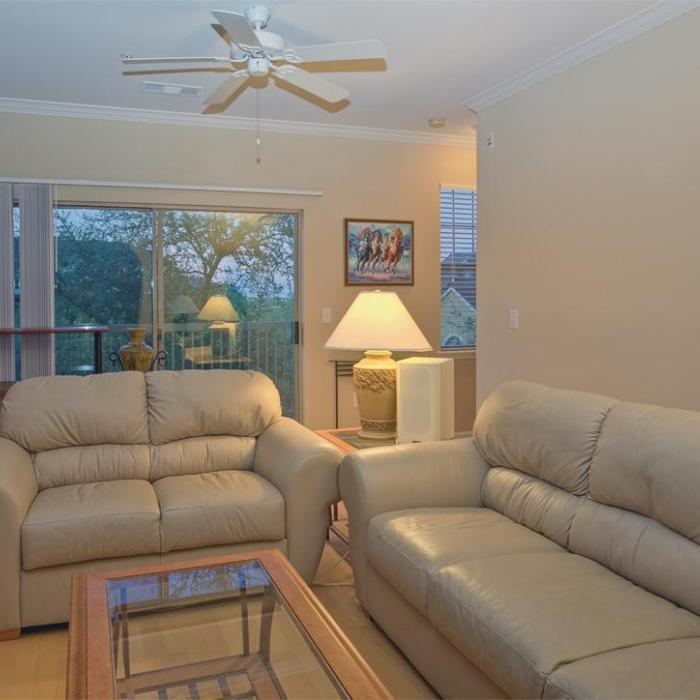

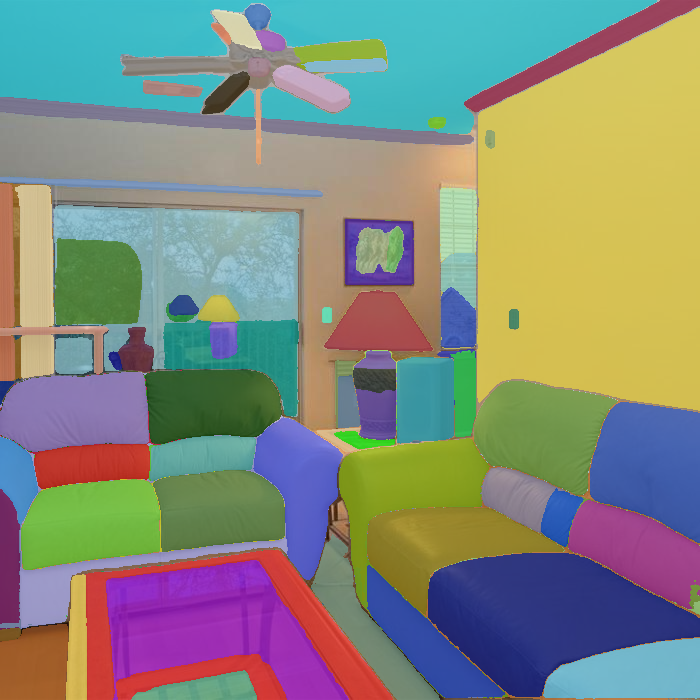





========================== underestimated ==========================




Complexity: 79.6, Pred: 60.4, Num unique: 14 (53.0/100) Num seg: 137 (59.0/100)
sun_bdnwochpwbdqtgbk.jpg


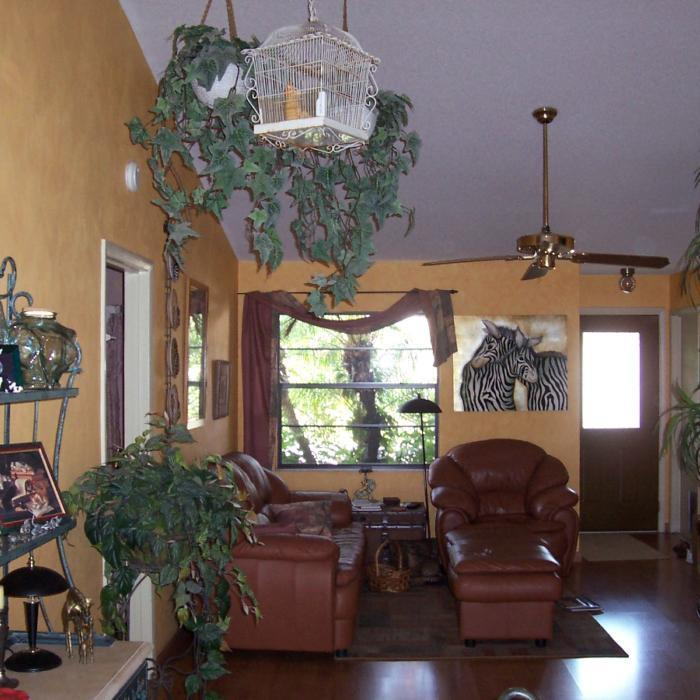

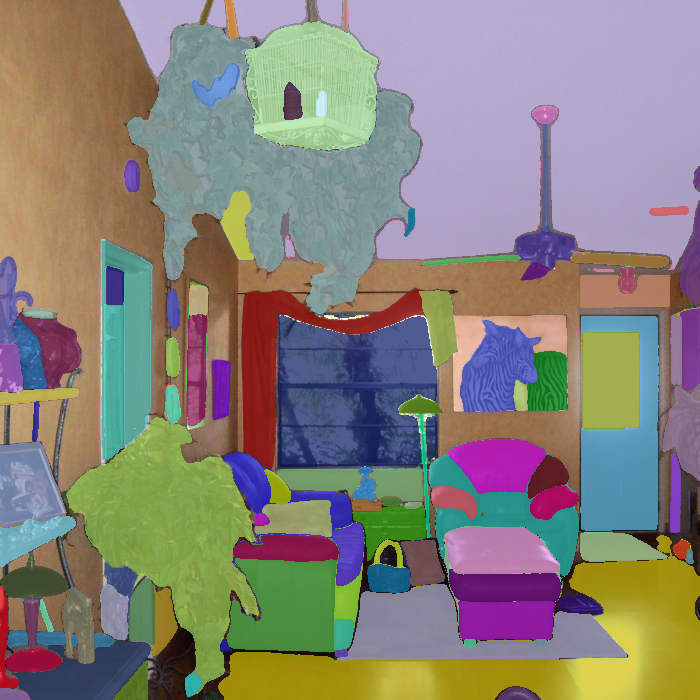

Complexity: 78.9, Pred: 63.1, Num unique: 12 (29.5/100) Num seg: 161 (81.0/100)
sun_azuyiwoejycfgxif.jpg


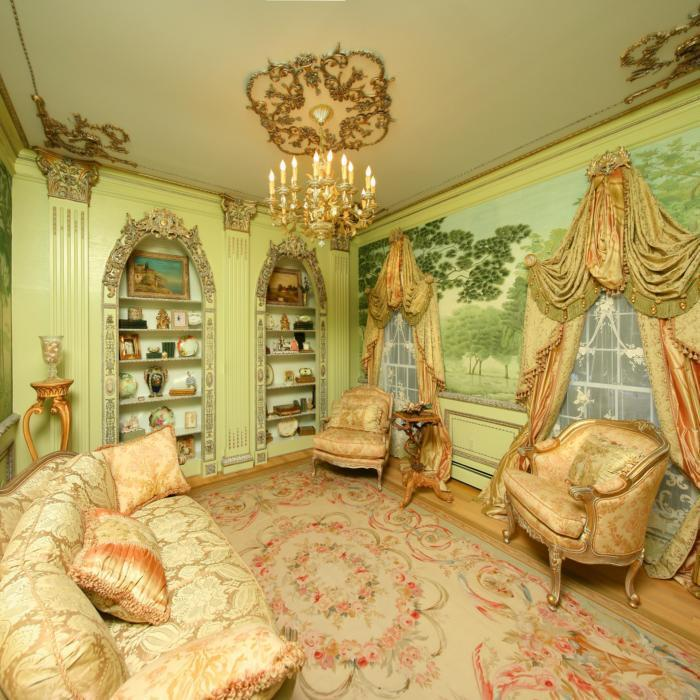

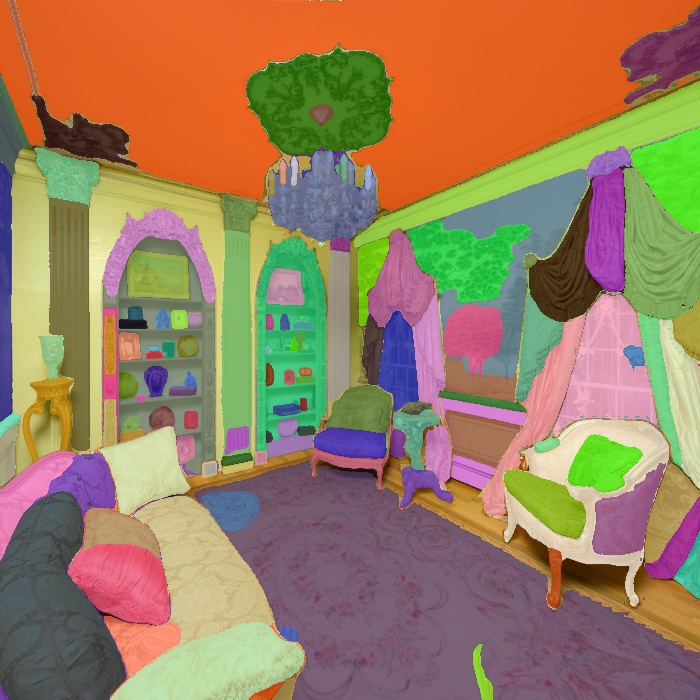

Complexity: 80.0, Pred: 62.1, Num unique: 18 (87.5/100) Num seg: 152 (76.0/100)
sun_blojyrvlkifrickr.jpg


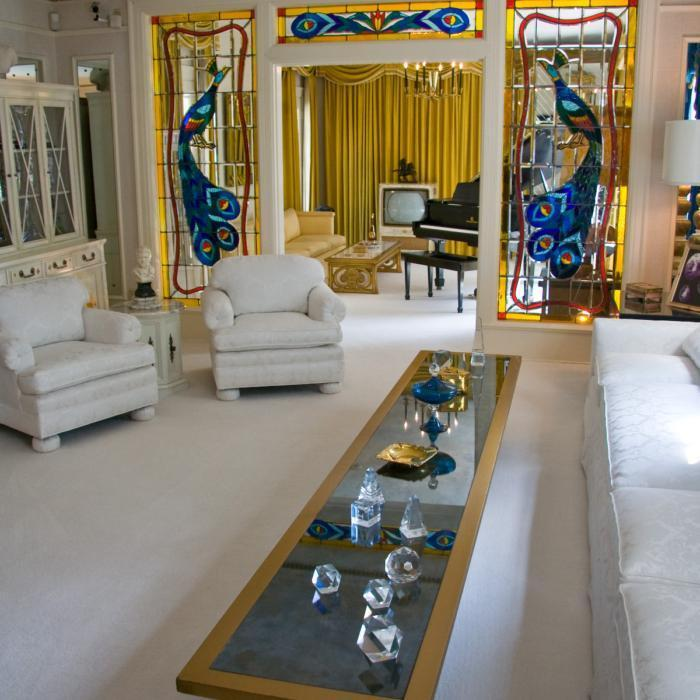

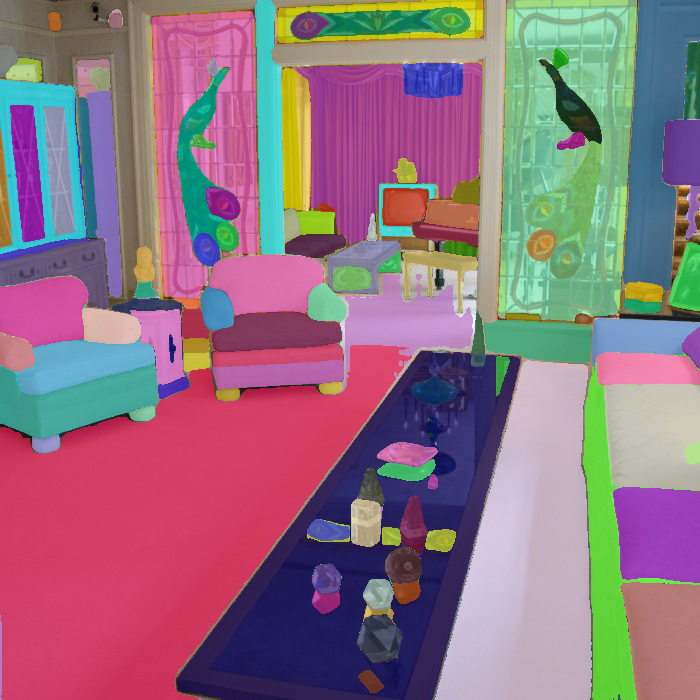





========================== accurate ==========================




Complexity: 61.8, Pred: 60.6, Num unique: 13 (43.0/100) Num seg: 139 (62.0/100)
sun_bajbxsbzlpsplebf.jpg


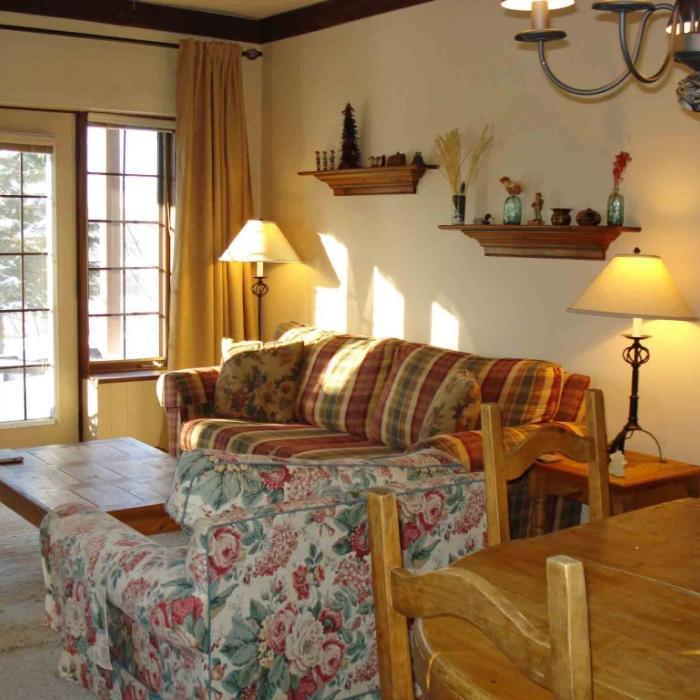

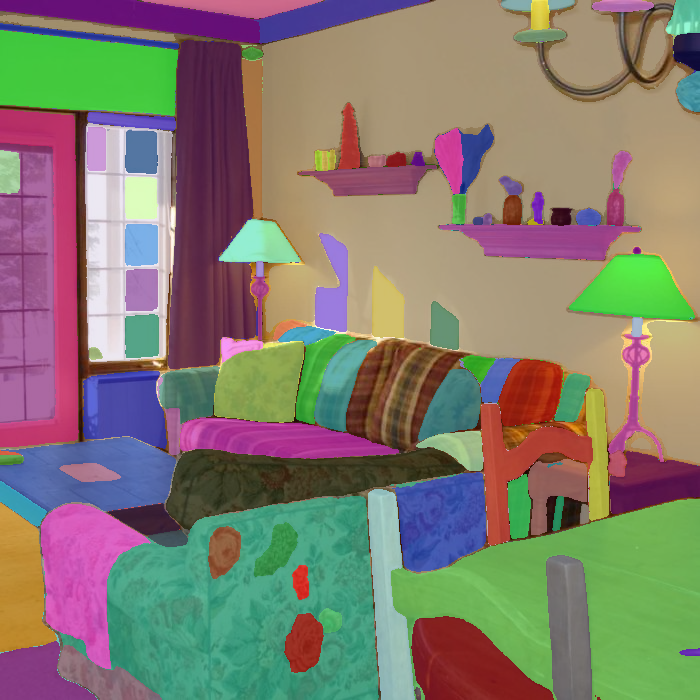

Complexity: 57.5, Pred: 58.8, Num unique: 14 (53.0/100) Num seg: 124 (49.0/100)
sun_bnmphahemonjytql.jpg


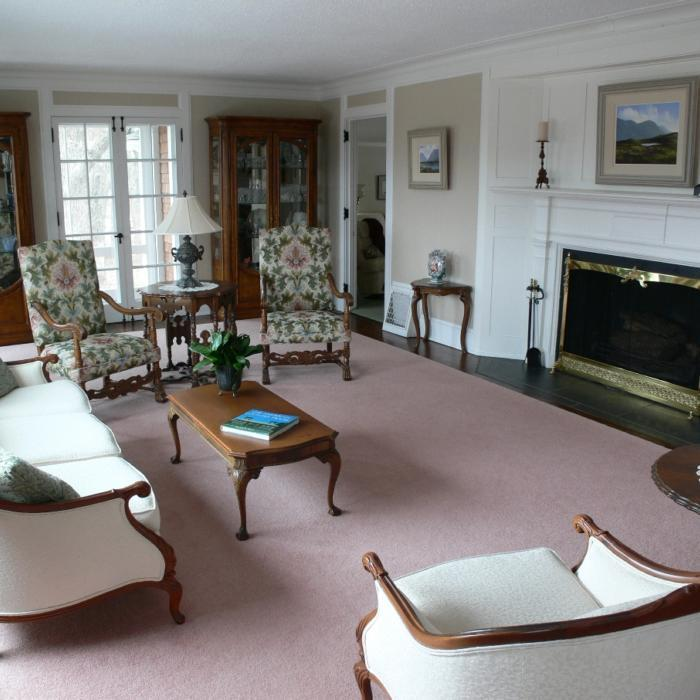

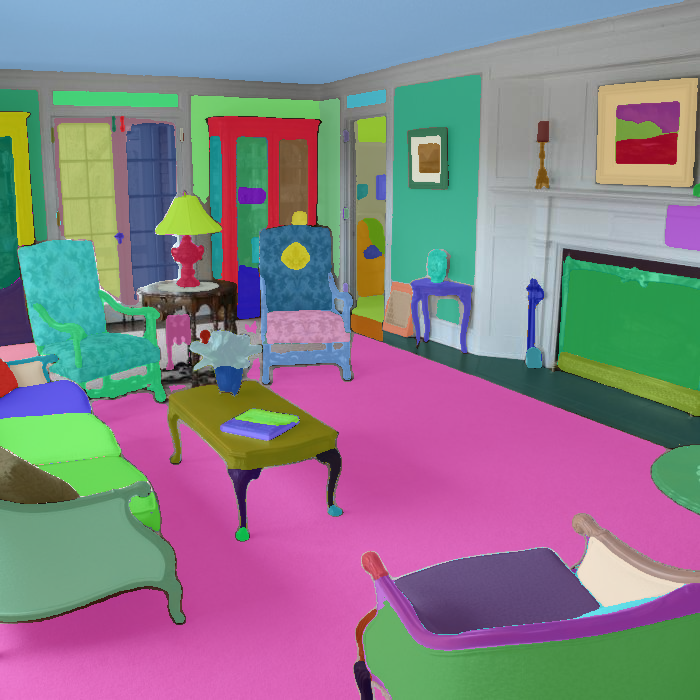

Complexity: 59.7, Pred: 59.3, Num unique: 14 (53.0/100) Num seg: 128 (52.0/100)
sun_bltpodkxbcoxzsbw.jpg


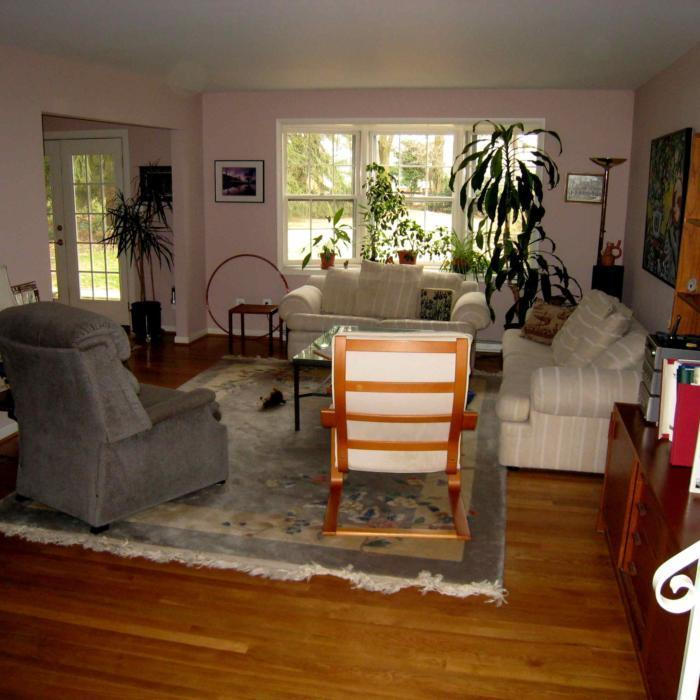

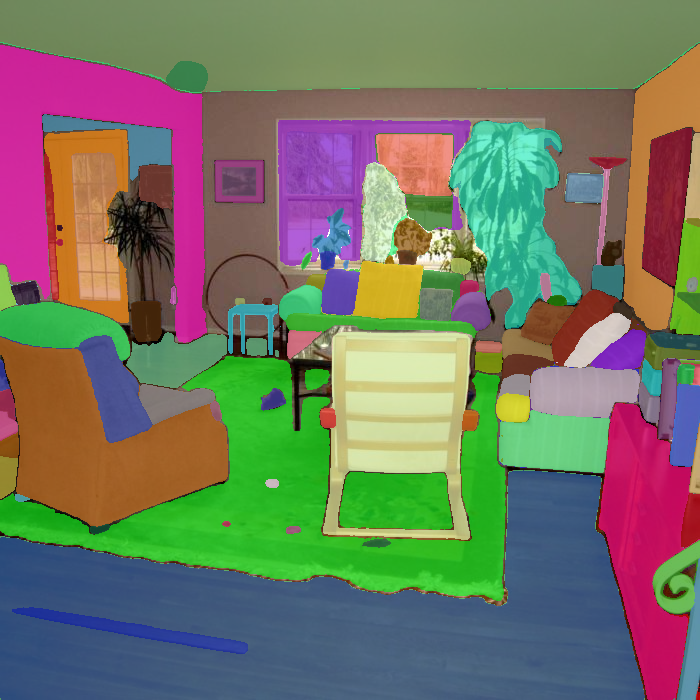

In [84]:
data['visc']['complexity_clean'] = data['visc'][["participant{}".format(i) for i in participants]].mean(axis=1)
df = data['visc'][data['visc']['category'].isin(
    ['living_room']
)]
df = df[['filename', '4points', '8points', '16points', '32points', '64points', 
         'complexity', 'complexity_clean', 'num_unique_classes', 'num_classes']].copy()
x = sqrt_xform(df["64points"])
y = df['complexity_clean']
f = np.poly1d(np.polyfit(x, y, 1))
get_correlations(x, y)
plt.scatter(x, y)
plt.show()
show_outliers(x, y, df, N=3)